# Student Performance Regression

**Author:** Jaden W

**Date:** 2026-02-09

**Purpose:** This notebook performs various types of regression on the **Student Test Performance Dataset**. The goal is to evaluate different regression methods and optimize effectiveness in predicting on this particular set of data, guiding future predictive methodologies.

**Dataset:** [Mobile Price Classification on Kaggle by A. Sharma](https://www.kaggle.com/datasets/iabhishekofficial/mobile-price-classification)

## Contents:

[1 Data Import and Preprocessing](#1-data-import-and-preprocessing)
- [1.1 Imports & Setup](#11-imports-&-setup)
- [1.2 Dataset Preprocessing](#12-dataset-preprocessing)
- [1.3 Data Inspection](#13-data-inspection)

[2 Validate Regression Assumptions](#2-validate-regression-assumptions)
- [2.1 Linear Assumption](#21-linear-assumption)
- [2.2 Homoscedasticity](#22-homoscedasticity)
- [2.3 Normality](#23-normality)
  - [2.3.1 Log Transformation](#231-log-transformation)
  - [2.3.2 Sqrt Transformation](#232-sqrt-transformation)
  - [2.3.3 Boxcox Transformation](#233-boxcox-transformation)
- [2.4 Multicollinearity](#24-multicollinearity)

[3 Regression](#3-regression)
- [3.1 Linear Regression](#31-linear-regression)
- [3.2 Linear Regression with Pipeline](#32-linear-regression-with-pipeline)
- [3.3 Single-Feature Linear Regression](#33-single-feature-linear-regresssion)

[4 Polynomial Regression](#4-polynomial-regression)
- [4.1 Polynomial Regression with GridSearchCV](#41-polynomial-regression-with-gridsearchcv)
- [4.2 Single-Feature Polynomial Regression with GridSearchCV](#42-single-feature-polynomial-regression-with-gridsearchcv)

[5 K Fold](#5-k-fold)
- [5.1 K Fold as Cross Validation](#51-k-fold-as-cross-validation)
- [5.2 K Fold with cross_val_score](#52-k-fold-with-cross_val_score)
- [5.3 K Fold as a Pipeline](#53-k-fold-as-a-pipeline)

[6 L1 and L2 Regularization](#6-l1-and-l2-regularization)
- [6.1 Lasso Regression](#61-lasso-regression)
- [6.2 Lasso Regression with Polynomial Feature Engineering](#62-lasso-regression-with-polynomial-feature-engineering)
- [6.3 Lasso Regression with Pipeline](#63-lasso-regression-with-pipeline)
- [6.4 Ridge Regression](#64-ridge-regression)
- [6.5 Ridge Regression with GridSearchCV](#65-ridge-regression-with-gridsearchcv)

## 1 Data Import and Preprocessing
### 1.1 Imports & Setup
Imports core libraries for data handling, visualization, statistical analysis and machine learning.

In [44]:
# Utilities
from tqdm import tqdm
import os

# Data manipulation
import numpy as np
import pandas as pd

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Statistical tools
import scipy.optimize as opt

# Kaggle integration
import kagglehub

# Sklearn machine learning
from sklearn import metrics, preprocessing, tree
from sklearn.model_selection import StratifiedShuffleSplit, train_test_split, learning_curve, GridSearchCV
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV, SGDClassifier
from sklearn.metrics import (precision_recall_fscore_support, precision_score, precision_recall_curve,
                             ConfusionMatrixDisplay, confusion_matrix,
                             accuracy_score, roc_auc_score, f1_score, recall_score,
                             classification_report, mean_squared_error, roc_curve)
from sklearn.preprocessing import label_binarize, LabelBinarizer, OneHotEncoder, LabelEncoder, OrdinalEncoder, MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC, SVC
from sklearn.kernel_approximation import Nystroem
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor, export_graphviz, plot_tree, export_text
from sklearn.ensemble import (BaggingClassifier, RandomForestClassifier, ExtraTreesClassifier, GradientBoostingClassifier,
                              AdaBoostClassifier, VotingClassifier, StackingClassifier)
from sklearn.utils import resample
from sklearn.inspection import permutation_importance


import pydotplus
import warnings
import os
import pylab as plt
from imblearn.under_sampling import RandomUnderSampler
from io import StringIO
import lime.lime_tabular
from xgboost import XGBClassifier
from IPython.display import Image

Load dataset from Kaggle and read into a pandas dataframe.

In [20]:
path = kagglehub.dataset_download("iabhishekofficial/mobile-price-classification")
csv_file = os.path.join(path, "train.csv")
df = pd.read_csv(csv_file)

Define `random_state`.

In [21]:
random_state = 6767

Suppress warnings.

In [22]:
def warn(*args, **kwargs):
    pass
warnings.warn = warn
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=RuntimeWarning)

### 1.2 Dataset Inspection
Preview data.

In [23]:
df.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


Observe data distribution.

In [24]:
df.iloc[:].describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,...,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,...,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,...,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,...,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,...,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,...,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,...,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


Observe the number of unique values for each category.

In [25]:
# Observe the number of unique values for each variable
df_uniques = pd.DataFrame([[i, len(df[i].unique())] for i in df.columns], columns=["Variable", "Unique Values"]).set_index("Variable")
print(df_uniques)

# Observe the list of binary variables
binary_variables = list(df_uniques[df_uniques["Unique Values"] == 2].index)
print("Binary Variables:", binary_variables)

# Observe the list of categorical variables
categorical_variables = list(df_uniques[(10 >= df_uniques["Unique Values"]) & (df_uniques["Unique Values"]>2)].index)
print("Categorical Variables:", categorical_variables)

               Unique Values
Variable                    
battery_power           1094
blue                       2
clock_speed               26
dual_sim                   2
fc                        20
four_g                     2
int_memory                63
m_dep                     10
mobile_wt                121
n_cores                    8
pc                        21
px_height               1137
px_width                1109
ram                     1562
sc_h                      15
sc_w                      19
talk_time                 19
three_g                    2
touch_screen               2
wifi                       2
price_range                4
Binary Variables: ['blue', 'dual_sim', 'four_g', 'three_g', 'touch_screen', 'wifi']
Categorical Variables: ['m_dep', 'n_cores', 'price_range']


For each categorical variable, observe each category's value.

In [26]:
[[i, list(df[i].unique())] for i in categorical_variables]

[['m_dep',
  [np.float64(0.6),
   np.float64(0.7),
   np.float64(0.9),
   np.float64(0.8),
   np.float64(0.1),
   np.float64(0.5),
   np.float64(1.0),
   np.float64(0.3),
   np.float64(0.4),
   np.float64(0.2)]],
 ['n_cores',
  [np.int64(2),
   np.int64(3),
   np.int64(5),
   np.int64(6),
   np.int64(1),
   np.int64(8),
   np.int64(4),
   np.int64(7)]],
 ['price_range', [np.int64(1), np.int64(2), np.int64(3), np.int64(0)]]]

Visualize the numeric variables.

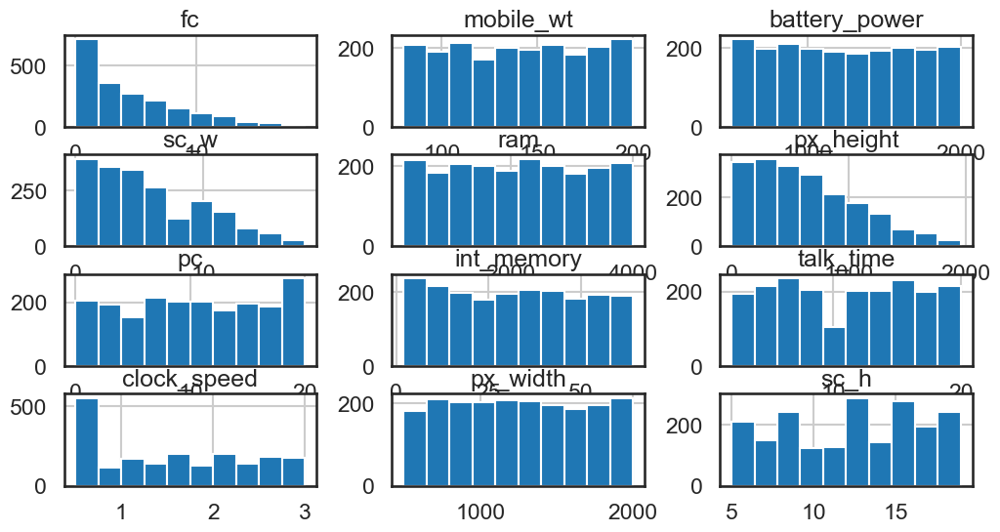

In [27]:
numeric_variables = list(set(df.columns) - set(categorical_variables) - set(binary_variables))
df[numeric_variables].hist(figsize=(12,6));

Observe the distribution of the target variable, `price_range`.

In [28]:
df.iloc[:, -1:].value_counts()

price_range
0              500
1              500
2              500
3              500
Name: count, dtype: int64

As observable, the dataset has 4 classes. Each of these classes are equally distributed and balanced.

## 2 Exploratory Data Analysis
### 2.1 Feature-Target Correlations

Observe the correlation between the feature variables and the target variable.

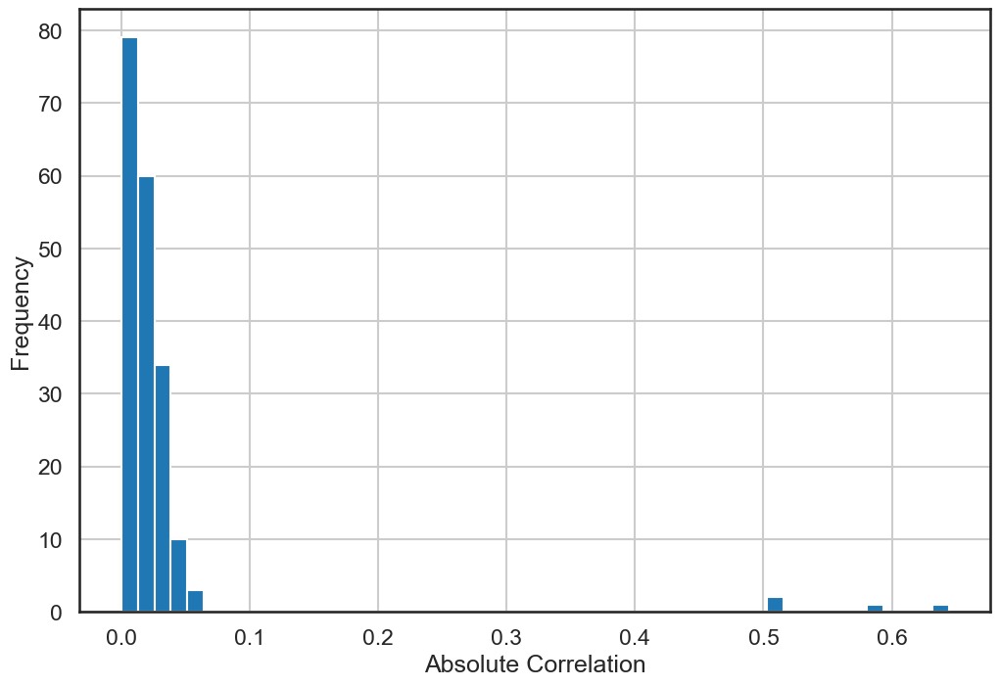

In [29]:
feature_cols = df.columns[:-1]
corr_values = df[feature_cols].corr()

# Simplify by emptying data below the diagonal (removes duplicates & self-correlations)
tril_index = np.tril_indices_from(corr_values)

for coord in zip(*tril_index):
    corr_values.iloc[coord[0],coord[1]] = np.nan

# Convert matrix to a dataframe
corr_values = (corr_values
               .stack()
               .to_frame()
               .reset_index()
               .rename(columns={"level_0":"feature1",
                                "level_1":"feature2",
                                0: "correlation"}))

corr_values["abs_correlation"] = corr_values.correlation.abs()

sns.set_context("talk")
sns.set_style("white")

ax = corr_values.abs_correlation.hist(bins=50, figsize=(12,8))
ax.set(xlabel="Absolute Correlation", ylabel="Frequency");

Observe the independent correlation values between the `price_range` and feature variables.

In [30]:
target_var = "price_range"

y = (df[target_var])
correlations = df[feature_cols].corrwith(y)
correlations.sort_values(inplace=True)
correlations

touch_screen    -0.030411
mobile_wt       -0.030302
clock_speed     -0.006606
m_dep            0.000853
n_cores          0.004399
four_g           0.014772
dual_sim         0.017444
wifi             0.018785
blue             0.020573
talk_time        0.021859
fc               0.021998
sc_h             0.022986
three_g          0.023611
pc               0.033599
sc_w             0.038711
int_memory       0.044435
px_height        0.148858
px_width         0.165818
battery_power    0.200723
ram              0.917046
dtype: float64

## 2.2 Multicollinearity
Observe correlations between each feature variable and create a heatmap to visualize results.

Correlation may indicate multicollinearity, which causes instability and less reliable models.

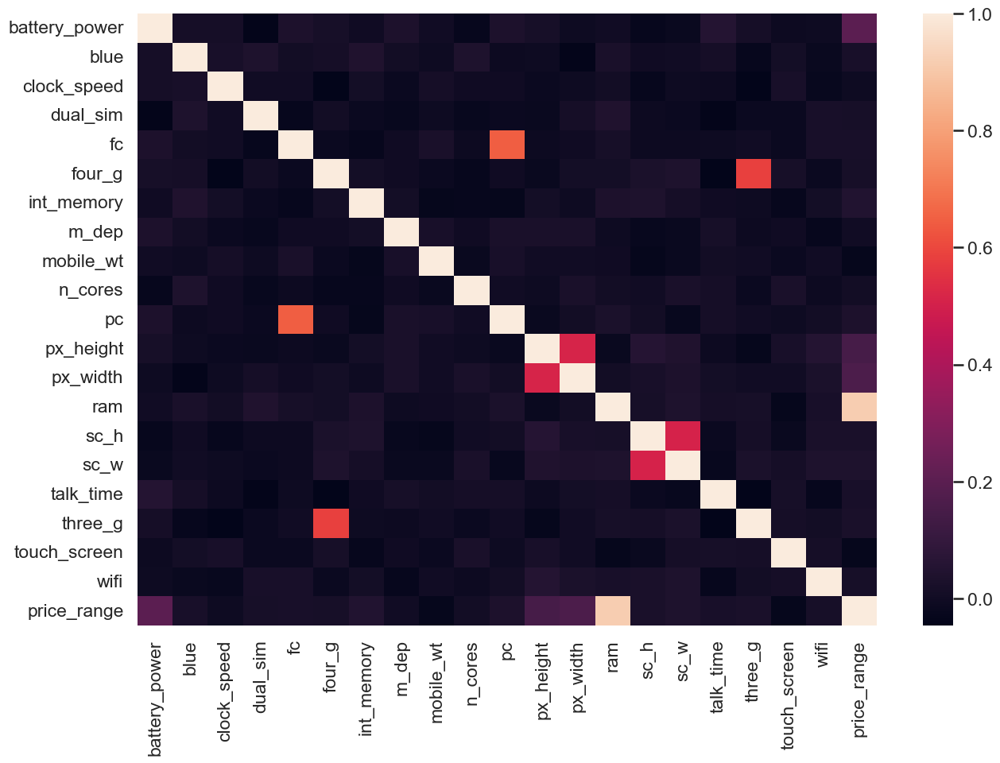

In [31]:
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(df.corr());

Also visualize the results with a pairplot.

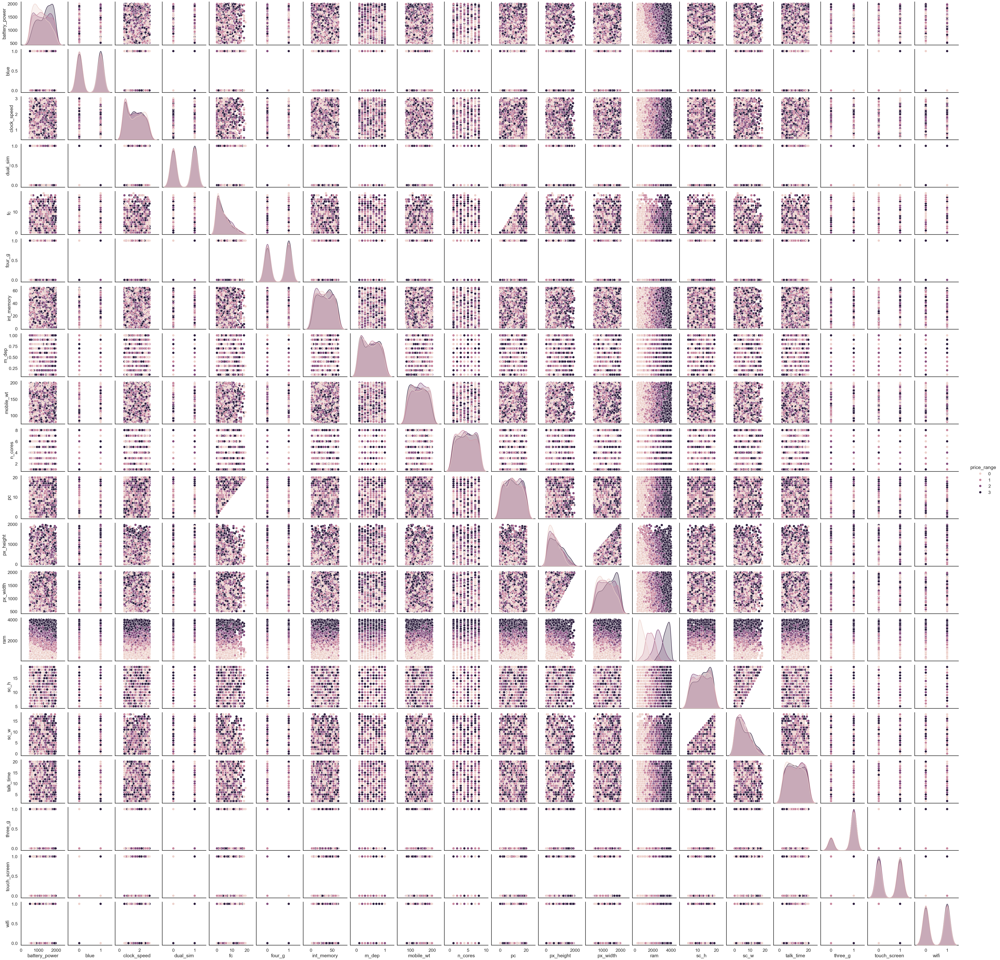

In [ ]:
sns.pairplot(df, hue=target_var);

Observe the correlation values for each of the feature-feature interactions.

In [33]:
corr_values.sort_values("correlation", ascending=False)

,feature1,feature2,correlation,abs_correlation
75,fc,pc,0.644595,0.644595
96,four_g,three_g,0.584246,0.584246
154,px_height,px_width,0.510664,0.510664
175,sc_h,sc_w,0.506144,0.506144
156,px_height,sc_h,0.059615,0.059615
...,...,...,...,...
2,battery_power,dual_sim,-0.041847,0.041847
184,talk_time,three_g,-0.042688,0.042688
39,clock_speed,four_g,-0.043073,0.043073
51,clock_speed,three_g,-0.046433,0.046433


## 3 Regression
### 3.1 LR, L1 and L2 Regression

Use Stratified Shuffle Split to divide our data. Stratified Shuffle Split allows us to create multiple test batches by reshuffling the data for every new split, also aiming to preserve the class proportions in each split.

In [34]:
# Use stratified shuffle split to create test batches
strat_shuf_split = StratifiedShuffleSplit(n_splits=1,
                                          test_size=0.3,
                                          random_state=6767)

# Create train and test indexes
train_index, test_index = next(strat_shuf_split.split(df[feature_cols], df[target_var]))

# Train splits
X_train = df.loc[train_index, feature_cols]
y_train = df.loc[train_index, target_var]

# Test splits
X_test = df.loc[test_index, feature_cols]
y_test = df.loc[test_index, target_var]

# Observe fractions of the total
y_train.value_counts(normalize=True)

price_range
3    0.25
1    0.25
0    0.25
2    0.25
Name: proportion, dtype: float64

Conduct "binary" logistic regression using a "one-vs-rest" strategy, running 4 seperate binary logistic regressions behind the scene, L1 logistic regression and L2 logistic regrssion.

In [35]:
solver = "liblinear"
cs = 10
cv = 4

# Define regression models
lr = LogisticRegression(solver=solver).fit(X_train, y_train)
lr_l1 = LogisticRegressionCV(Cs=cs, cv=cv,
                             penalty="l1", solver=solver).fit(X_train, y_train)
lr_l2 = LogisticRegressionCV(Cs=cs, cv=cv,
                             penalty="l2", solver=solver).fit(X_train, y_train)

Compare the magnitudes of the coefficients for each of the models.

Note that the target variable price_range has 4 classes: 0, 1, 2, 3 and multiclass logistic regression learns one coefficient vector per class.

In [36]:
# Define variables 
coefficients = list()
coeff_labels = ["lr", "l1", "l2"]
coeff_models = [lr, lr_l1, lr_l2]

# Obtain coefficients
for lab,mod in zip (coeff_labels, coeff_models):
    coeffs = mod.coef_
    coeff_label = pd.MultiIndex(levels=[[lab], list(range(4))],
                                codes=[[0,0,0,0], list(range(4))])
    coefficients.append(pd.DataFrame(coeffs.T, index=feature_cols, columns=coeff_label))

# Display the coefficients for each model
coefficients = pd.concat(coefficients, axis=1)
coefficients.sample(5)

lr                                      l1            \
                    0         1         2         3         0    1    2   
fc          -0.014272 -0.002339 -0.005182  0.038445 -0.020122  0.0  0.0   
m_dep        0.718604  0.006963 -0.255063 -0.787793 -0.034603  0.0  0.0   
dual_sim     0.505088  0.000201 -0.269190 -0.232554  0.121001  0.0  0.0   
pc           0.029118  0.002115 -0.006907 -0.049927  0.000000  0.0  0.0   
clock_speed  0.553056 -0.020784 -0.005795 -0.305826  0.181301  0.0  0.0   

                             l2                                
                    3         0         1         2         3  
fc           0.062762 -0.027704 -0.000030 -0.003591  0.029855  
m_dep       -0.078280  0.702883  0.000551 -0.000837 -0.948742  
dual_sim     0.106259  0.626179 -0.000021 -0.001749 -0.155850  
pc          -0.039041  0.046175  0.000907 -0.007408 -0.037419  
clock_speed  0.000000  0.646498 -0.001727 -0.000707 -0.107217

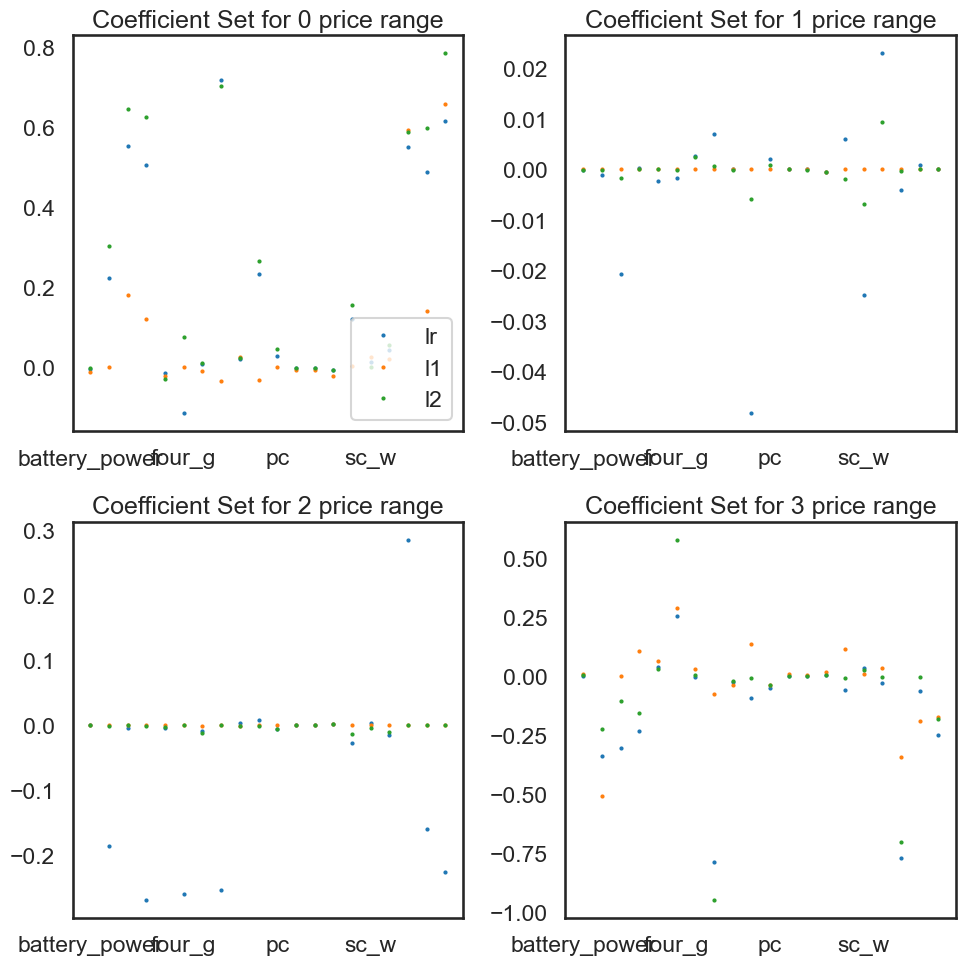

In [37]:
# Create plots
fig, axList = plt.subplots(nrows=2, ncols=2)
axList = axList.flatten()
fig.set_size_inches(10,10)

# Plot coefficients for each model and price range
for ax in enumerate(axList):
    loc = ax[0]
    ax = ax[1]

    data = coefficients.xs(loc, level=1, axis=1)
    data.plot(marker="o", ls="", ms=2.0, ax=ax, legend=False)

    if ax is axList[0]:
        ax.legend(loc=4)
    
    ax.set(title="Coefficient Set for "+str(loc)+" price range")

plt.tight_layout()

Apply our models to the test set.

In [38]:
y_pred = list()
y_prob = list()

for lab, mod in zip(coeff_labels, coeff_models):
    y_pred.append(pd.Series(mod.predict(X_test), name=lab))
    y_prob.append(pd.Series(mod.predict_proba(X_test).max(axis=1), name=lab))

y_pred = pd.concat(y_pred, axis=1)
y_prob = pd.concat(y_prob, axis=1)

y_pred.head() # Display predictions for each model

,lr,l1,l2
0,2,2,2
1,0,0,0
2,3,3,3
3,3,3,3
4,2,2,2


In [39]:
# The probability for each class
y_prob.head()

,lr,l1,l2
0,0.512192,0.545917,0.512409
1,0.609987,0.646269,0.625721
2,0.473551,0.680877,0.565780
3,0.496993,0.650702,0.611708
4,0.467760,0.651431,0.628920


Calculate error metrics for each model.

In [40]:
error_metrics = list()
confus_mat = dict()
average = "weighted"

for lab in coeff_labels:
    # Precision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = precision_recall_fscore_support(y_test, y_pred[lab], average=average)

    accuracy = accuracy_score(y_test, y_pred[lab])

    area_under_curve = roc_auc_score(label_binarize(y_test, classes=list(range(4))),
                        label_binarize(y_pred[lab], classes=list(range(4))),
                        average=average)
    confus_mat[lab] = confusion_matrix(y_test, y_pred[lab])

    error_metrics.append(pd.Series({"precision":precision, "recall":recall,
                              "fscore":fscore, "accuracy":accuracy,
                              "auc":area_under_curve},
                              name=lab))
    
error_metrics = pd.concat(error_metrics, axis=1)
error_metrics

,lr,l1,l2
precision,0.769915,0.821463,0.761175
recall,0.778333,0.825000,0.771667
fscore,0.770958,0.821692,0.764498
accuracy,0.778333,0.825000,0.771667
auc,0.852222,0.883333,0.847778


Display the confusion matrix for each model.

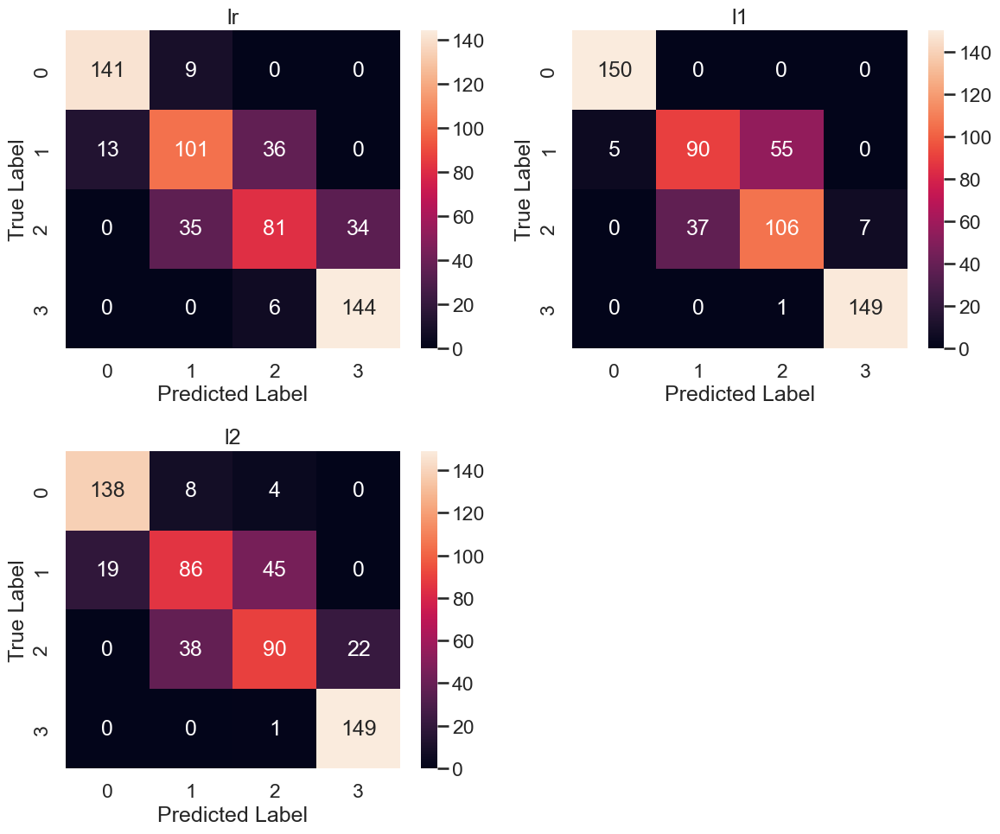

In [41]:
# Define axis
fig, axList = plt.subplots(nrows=2, ncols=2)
axList = axList.flatten()
fig.set_size_inches(12,10)
axList[-1].axis("off")

# Plot heat maps
for ax, lab in zip(axList[:-1], coeff_labels):
    sns.heatmap(confus_mat[lab], ax=ax, annot=True, fmt="d")
    ax.set(title=lab)
    ax.set_xlabel("Predicted Label")
    ax.set_ylabel("True Label")

plt.tight_layout()

### 3.2 L2 Logistic Regression

Now conduct multinomial logistic regression, which will handle all target-variables directly in one model. 

In [ ]:
# Scale the features using MinMaxScaler
scaler = MinMaxScaler()
X_train_s = scaler.fit_transform(X_train)
X_test_s = scaler.transform(X_test)

# Verified scaled features
print(f"The range of feature inputs are within {X_train_s.min()}  to {X_train_s.max()}")

The range of feature inputs are within 0.0  to 1.0000000000000002


In [48]:
# Observe the shapes of the split datasets
print (f"Training dataset shape:\nX_train_s: {X_train_s.shape}\n\
y_train: {y_train.shape}\n")
print (f"Testing dataset shape:\nX_test_s: {X_test_s.shape}\n\
y_test: {y_test.shape}")

Training dataset shape:
X_train_s: (1400, 20)
y_train: (1400,)

Testing dataset shape:
X_test_s: (600, 20)
y_test: (600,)


Train the multinomial logistic regresion model.

In [49]:
# Define a logistic regression model with the arguments
multinomial_lr_l2 = LogisticRegression(random_state=random_state,
                                       penalty="l2",
                                       multi_class="multinomial",
                                       solver="lbfgs", # Use lbfgs for L2 and multinomial
                                       max_iter=1000)

# Train the model
multinomial_lr_l2.fit(X_train_s, y_train)

,penalty,'l2'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,6767
,solver,'lbfgs'
,max_iter,1000
,multi_class,'multinomial'


In [66]:
# Predict on test sets
y_pred = multinomial_lr_l2.predict(X_test_s)

Define a function to take ground truths y_test and the prediction y_pred, returning a python dict with `accuracy`, `recall`, `precision`, and `f1score`.

In [67]:
def evaluate_metrics(yt, yp):
    results_pos = {}

    # Calculate scores
    precision, recall, fscore, _ = precision_recall_fscore_support(yt, yp)

    # Store scores into dictionary
    results_pos["accuracy"] = accuracy_score(yt, yp)
    results_pos["precision"] = precision
    results_pos["recall"] = recall
    results_pos["fscore"] = fscore
    return results_pos

Examine the results of our logistic regression model.

In [68]:
evaluate_metrics(y_test, y_pred)

{'accuracy': 0.915,
 'precision': array([0.93630573, 0.84810127, 0.93076923, 0.9483871 ]),
 'recall': array([0.98      , 0.89333333, 0.80666667, 0.98      ]),
 'fscore': array([0.95765472, 0.87012987, 0.86428571, 0.96393443])}

The logistic regression has moderate model performance on this multinomial classification task. The overall accuracy is aroudn 0.67 and the f1 score is around 0.8.
### 3.3 L1 Logistic Regression
Now try defining another logistic regression model with l1 penalty and see if the classification performance is improved.

In [69]:
# Define a logistic regression model with the arguments
multinomial_lr_l1 = LogisticRegression(random_state=random_state,
                                       penalty="l1",
                                       multi_class="multinomial",
                                       solver="saga", # Use saga for L2 and multinomial
                                       max_iter=1000)

# Train the model
multinomial_lr_l1.fit(X_train_s, y_train)

,penalty,'l1'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,6767
,solver,'saga'
,max_iter,1000
,multi_class,'multinomial'


In [70]:
y_pred = multinomial_lr_l1.predict(X_test_s)

# Check the class probability distribution on the first instance in the test dataset
multinomial_lr_l1.predict_proba(X_test_s[:1, :])[0]

array([2.14892894e-02, 9.56460176e-01, 2.20505126e-02, 2.16173063e-08])

In this instance, class 1 has the highest probability of `54.7%`, therefore the model prediction for this instance will be class `1`.

In [71]:
multinomial_lr_l1.predict(X_test_s[:1,:])[0]

np.int64(1)

Given the true label y_test_s and prediction we can evaluate model performance by calling utility `evaluate_metrics` method.

In [72]:
evaluate_metrics(y_test, y_pred)

{'accuracy': 0.9716666666666667,
 'precision': array([0.98666667, 0.94155844, 0.97241379, 0.98675497]),
 'recall': array([0.98666667, 0.96666667, 0.94      , 0.99333333]),
 'fscore': array([0.98666667, 0.95394737, 0.9559322 , 0.99003322])}

The L1 penalty (Lasso) performed better than the L2 (Ridge) because it zeroed out less informative features, reducing noise and improving generalization on the multiclass classification task.

Plot the confusion matrix based on the true labels and predictions.

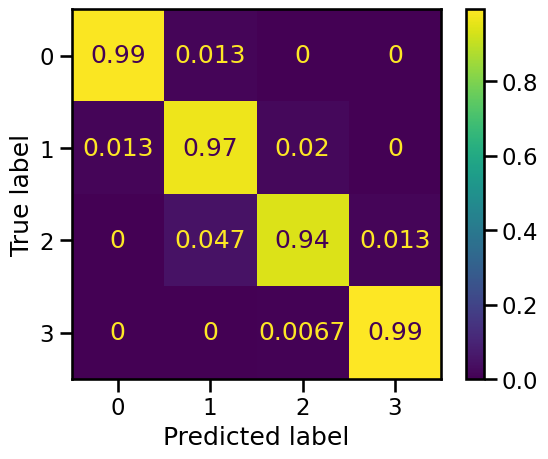

In [ ]:
confus_mat = confusion_matrix(y_test, y_pred, normalize="true")
confus_mat_disp = ConfusionMatrixDisplay(confusion_matrix=confus_mat, display_labels=multinomial_lr_l1.classes_)
confus_mat_disp.plot()
plt.show;

We may interpret logistic regression models by analyzing feature coefficients. Though not as effective due to the sigmoid function, we can still get a sense for the importance or impact of each feature.

In [74]:
multinomial_lr_l1.coef_

array([[-1.14515624e+01,  0.00000000e+00,  2.01207867e-01,
         8.71110431e-02,  0.00000000e+00,  0.00000000e+00,
        -1.99632966e-01,  0.00000000e+00,  1.20817653e+00,
         0.00000000e+00,  0.00000000e+00, -8.36366637e+00,
        -6.62711612e+00, -4.79467405e+01,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         3.49691848e-02,  3.14748962e-01],
       [-3.17380746e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         8.31945743e-07,  3.60430055e-01,  2.96598852e-01,
        -7.11454439e-02,  0.00000000e+00, -2.25023146e+00,
        -1.89847476e+00, -1.33428995e+01,  0.00000000e+00,
        -1.48480607e-01,  0.00000000e+00, -4.96439242e-02,
         0.00000000e+00,  5.79949351e-02],
       [ 3.11901218e+00,  5.16663044e-02,  0.00000000e+00,
        -1.13552783e-01,  0.00000000e+00,  0.00000000e+00,
        -1.92557329e-02,  0.00000000e+00, -2.41735303e-03,
         0.00000000e+00,  1.1

The `coef_` is a coefficients list, with one element for each category of the y-variable (0, 1, 2, 3).

In [75]:
# Define a function which extracts and sorts feature coefficients
def get_feature_coefs(regression_model, label_index, columns):
    coef_dict = {}

    # Extract feature coefficients
    for coef, feat in zip(regression_model.coef_[label_index, :], columns):
        coef_dict[feat] = coef
        
    # Sort coefficients
    coef_dict = {k: v for k, v in sorted(coef_dict.items(), key=lambda item: item[1])}
    return coef_dict
    
    

# Visualize coefficients
def visualize_coefs(coef_dict):
    features = list(coef_dict.keys())
    values = list(coef_dict.values())
    y_pos = np.arange(len(features))
    
    # Generalize bar colors based on if the value is positive or negative
    color_vals = []
    for val in values:
        if val <=0:
            color_vals.append("r")
        else:
            color_vals.append("g")

    plt.rcdefaults()
    fig, ax = plt.subplots()
    ax.barh(y_pos, values, align="center", color=color_vals)
    ax.set_yticks(y_pos)
    ax.set_yticklabels(features)
    # labels read top-to-bottom
    ax.invert_yaxis()
    ax.set_xlabel("Feature Coefficients")
    ax.set_title("")
    plt.show()

Visualize the sorted coefficients for `price range - 0`.

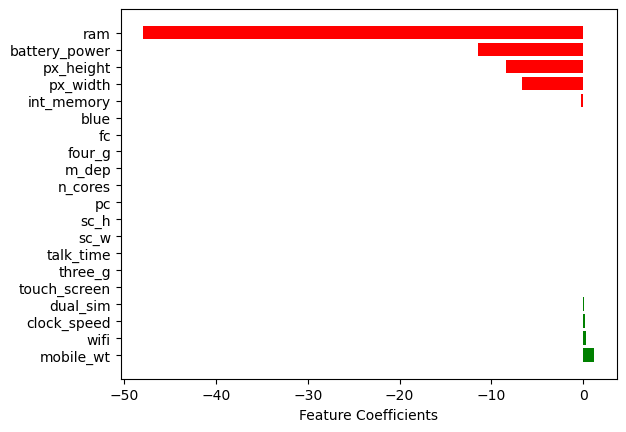

In [76]:
coef_dict = get_feature_coefs(multinomial_lr_l1, 0, feature_cols)
visualize_coefs(coef_dict)

As observed, items such as mobile weight, internal memory, and screen height have high positive coefficients. As such, larger physical properties of the phone have higher coefficients and are more likely to be categorized in the cheaper `0` class.

Now observe the coefficients for the opposite, the `3` class.

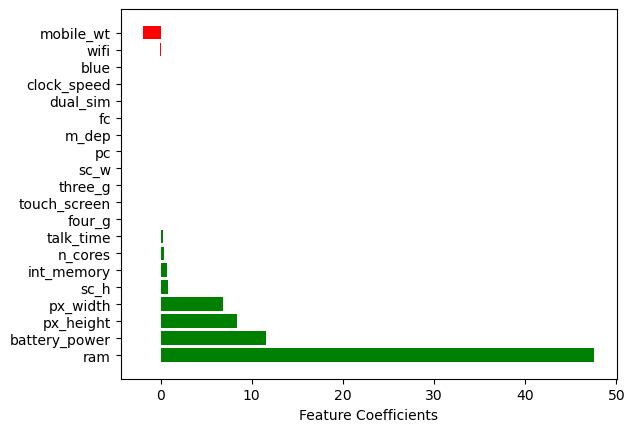

In [77]:
coef_dict = get_feature_coefs(multinomial_lr_l1, 3, feature_cols)
visualize_coefs(coef_dict)

As observable, conversely, higher ram, pixel resolution height and battery power contribute to positive coefficients. 
## 4 K Nearest Neighbours
When conducting KNN, keep in mind that KNN neighbors algorithm uses distance and requires scaled data.

              precision    recall  f1-score   support

           0       0.41      0.63      0.50       150
           1       0.24      0.28      0.26       150
           2       0.29      0.21      0.25       150
           3       0.53      0.31      0.39       150

    accuracy                           0.36       600
   macro avg       0.37      0.36      0.35       600
weighted avg       0.37      0.36      0.35       600

Accuracy score:  0.36
Weighted F1 Score:  0.35


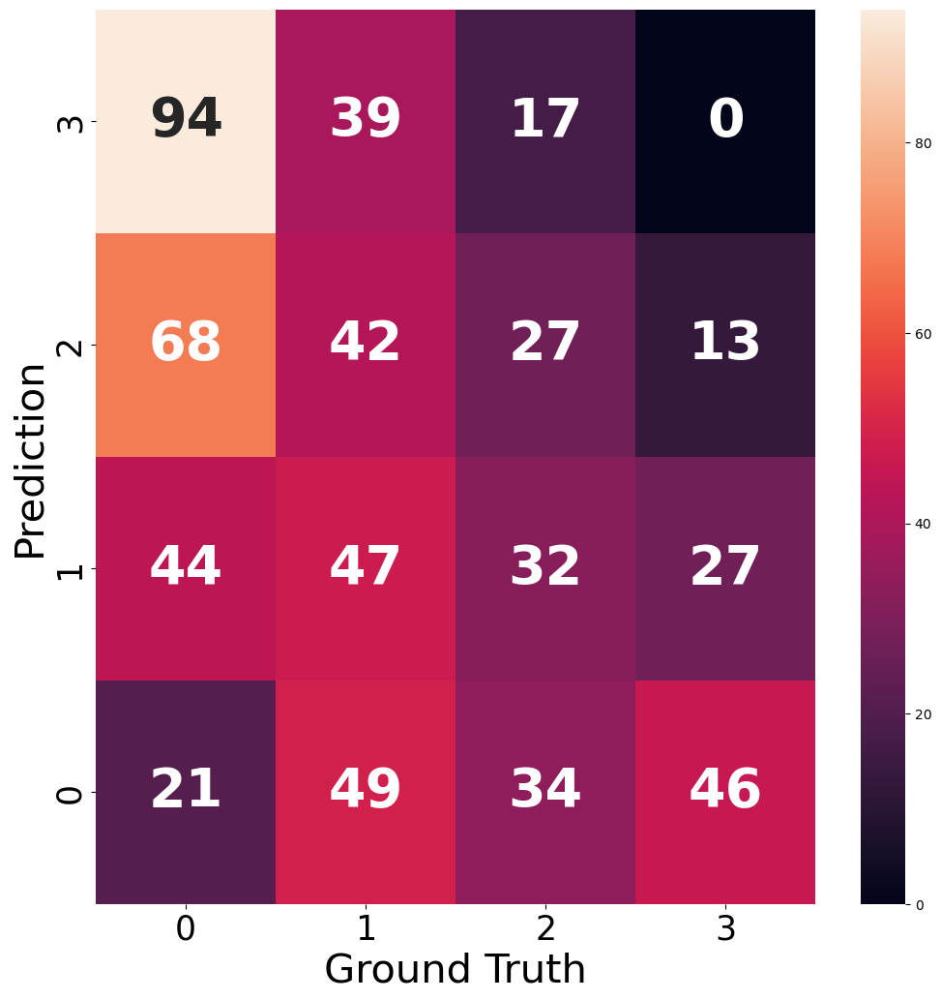

In [81]:
def conduct_KNN(X_train_s, y_train, X_test_s, y_test, n_neighbors):
    # Set up X and y variables
    knn = KNeighborsClassifier(n_neighbors=n_neighbors)
    knn = knn.fit(X_train_s, y_train)
    y_pred = knn.predict(X_test_s)

    print(classification_report(y_test, y_pred))
    print("Accuracy score: ", round(accuracy_score(y_test, y_pred),2))
    print("Weighted F1 Score: ", round(f1_score(y_test, y_pred, average="weighted"), 2))

    # Plot confusion matrix
    sns.set_palette(sns.color_palette())
    _, ax = plt.subplots(figsize=(12,12))
    ax = sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", annot_kws={"size": 40, "weight": "bold"})
    labels = (list(range(4)))
    ax.set_xticklabels(labels, fontsize=25)
    ax.set_yticklabels(labels[::-1], fontsize=25)
    ax.set_ylabel("Prediction", fontsize=30)
    ax.set_xlabel("Ground Truth", fontsize=30);

conduct_KNN(X_train_s, y_train, X_test_s, y_test, n_neighbors=3)

We'll use the same split of training and test samples, but estimate another KNN model using K=5 and weight the results by distance.

              precision    recall  f1-score   support

           0       0.49      0.60      0.54       150
           1       0.29      0.34      0.31       150
           2       0.33      0.31      0.32       150
           3       0.57      0.37      0.45       150

    accuracy                           0.41       600
   macro avg       0.42      0.40      0.40       600
weighted avg       0.42      0.41      0.40       600

Accuracy score:  0.41
Weighted F1 Score:  0.4


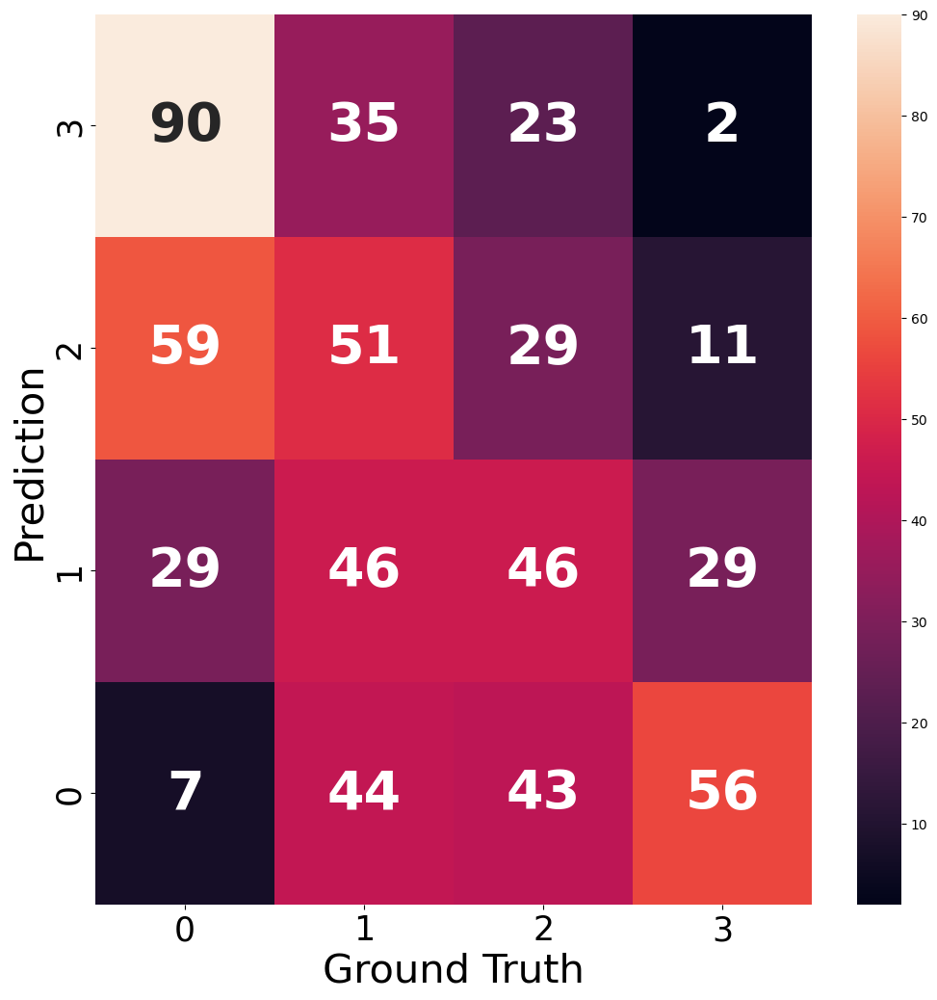

In [82]:
conduct_KNN(X_train_s, y_train, X_test_s, y_test, n_neighbors=5)

The accuracy is slightly better.

To optimize our K value, examine f1 score and error rate for values of K from 1-40. 

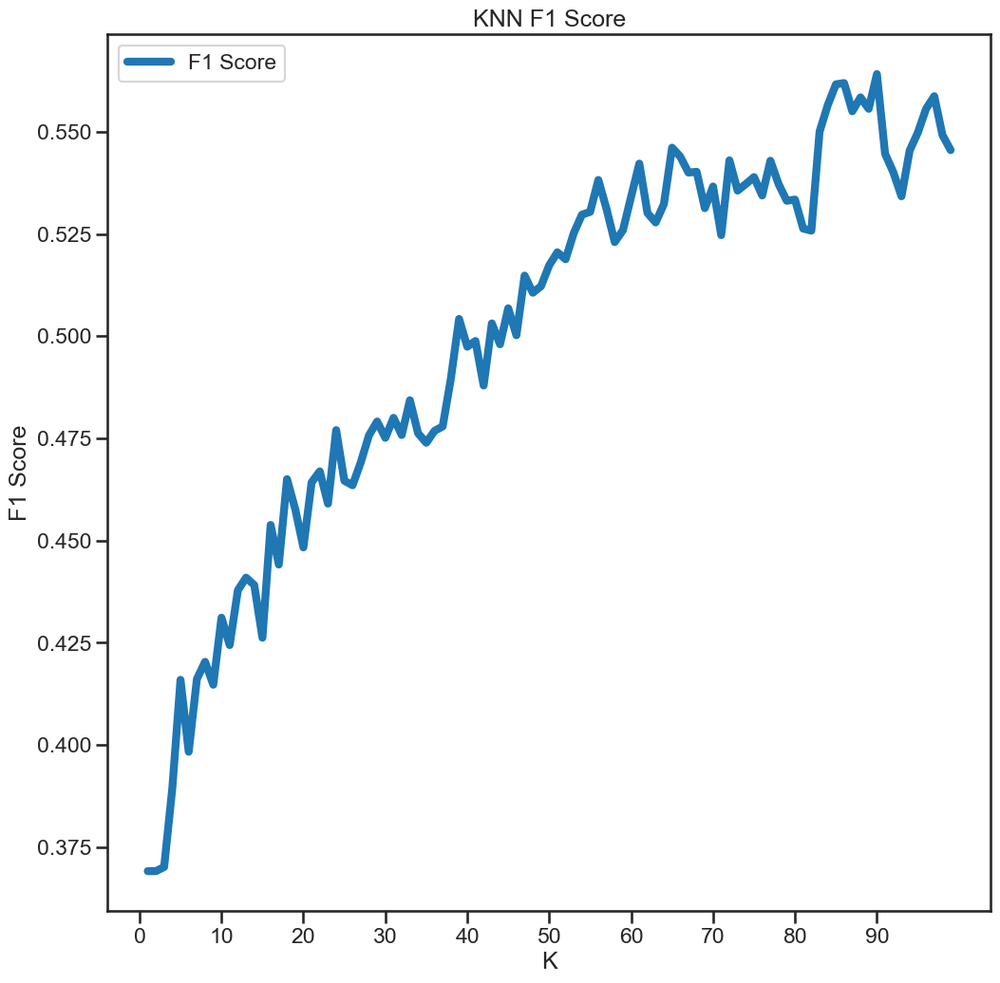

In [ ]:
f1_scores = list()
error_rates = list()
max_k = 100

for k in range(1, max_k):
    # Define our KNN object
    knn = KNeighborsClassifier(n_neighbors=k, weights="distance")
    knn = knn.fit(X_train_s, y_train)

    y_pred = knn.predict(X_test_s)
    f1_scores.append((k, round(f1_score(y_test, y_pred, average="weighted"),4)))
    error = 1-round(accuracy_score(y_test, y_pred), 4)
    error_rates.append((k, error))

f1_results = pd.DataFrame(f1_scores, columns=["K", "F1 Score"])
error_results = pd.DataFrame(error_rates, columns=["K", "Error Rate"])

# Plot F1 Results
sns.set_style("ticks")

ax = f1_results.set_index("K").plot(figsize=(12,12), linewidth=6)
ax.set(xlabel="K", ylabel="F1 Score")
ax.set_xticks(range(0, max_k, 10))
plt.title("KNN F1 Score");

Also observe the accuracy (error rate) results.

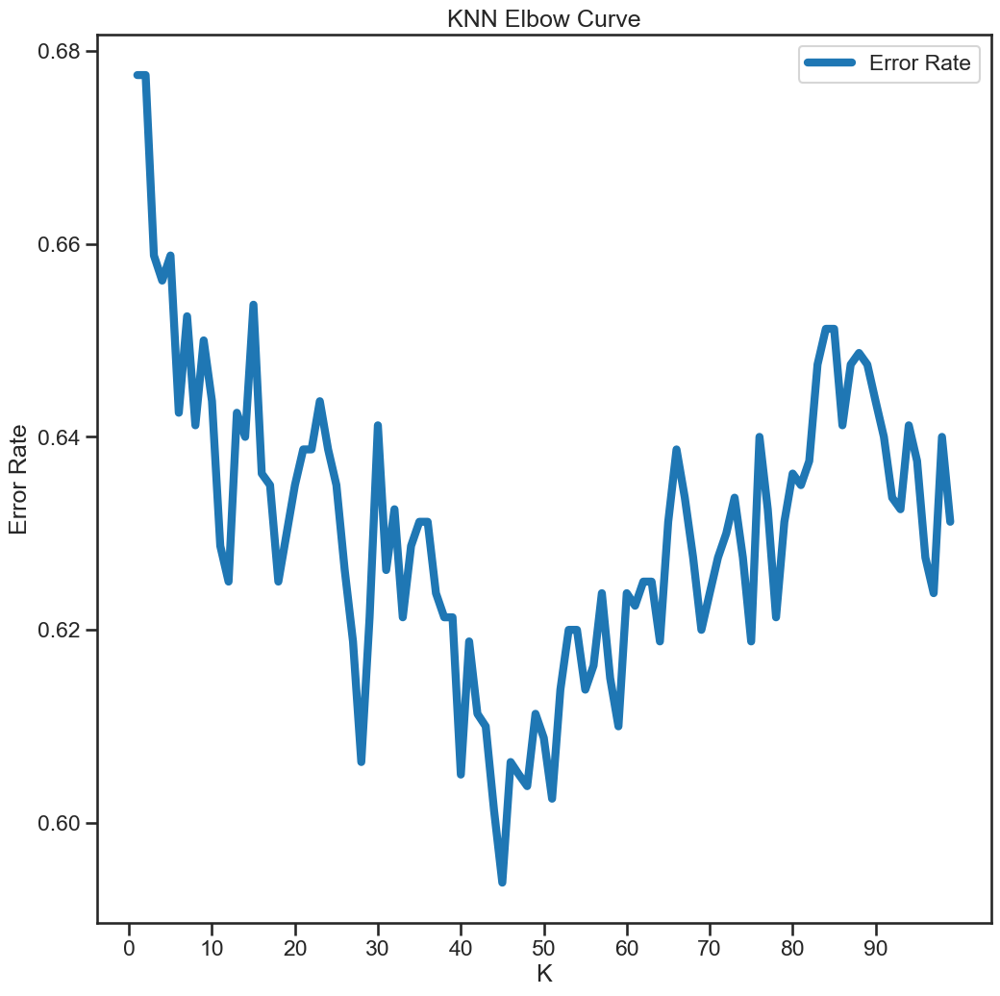

In [ ]:
ax = error_results.set_index("K").plot(figsize=(12,12), linewidth=6)
ax.set(xlabel="K", ylabel="Error Rate")
ax.set_xticks(range(0, max_k, 10))
plt.title("KNN Elbow Curve");

The best `k` value is around `45` with about `0.42` f1score.

## 5 Support Vector Machines
### 5.1 Linear SVC
Fit a Linear SVC to our training set.

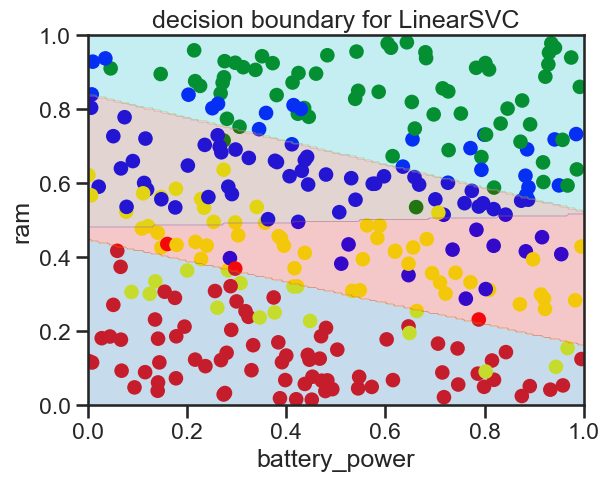

In [ ]:
# Select the two most correlated features
fields = correlations.map(abs).sort_values().iloc[-2:].index
field_indices = [X_train.columns.get_loc(f) for f in fields]

# Convert scaled X_train back to DataFrame
X_train_s_df = pd.DataFrame(X_train_s, columns=X_train.columns, index=X_train.index)

# Fit LinearSVC on scaled training data
lsvc = LinearSVC()
lsvc.fit(X_train_s[:,field_indices], y_train)

# Sample 300 points for visualization
X_color = X_train_s_df[fields].sample(300, random_state=random_state)
y_color = y_train.loc[X_color.index]

# Mpa target labels to colours
color_map = {
    0: "red",
    1: "yellow",
    2: "blue",
    3: "green"
}
y_color = y_color.map(color_map)

# Create figur eand scatter plots
ax = plt.axes()
ax.scatter(X_color.iloc[:, 0], X_color.iloc[:, 1],
           color=y_color, alpha=1)

# Create a grid for decision boundary
x_axis, y_axis = np.arange(0, 1.005, .005), np.arange(0, 1.005, .005)
xx, yy = np.meshgrid(x_axis, y_axis)

X_grid = pd.DataFrame([xx.ravel(), yy.ravel()]).T
y_grid_predictions = lsvc.predict(X_grid)
y_grid_predictions = y_grid_predictions.reshape(xx.shape)

# Plot the decision boundary
ax.contourf(xx, yy, y_grid_predictions, cmap=plt.cm.tab10, alpha=0.25)

# Labels and title
ax.set(
    xlabel=fields[0],
    ylabel=fields[1],
    xlim=[0,1],
    ylim=[0,1],
    title="decision boundary for LinearSVC");

plt.show()

### 5.2 SVC Gaussian
Fit a Gaussian SVC to our training set.

Gamma = 0.5	Accuracy = 0.8150


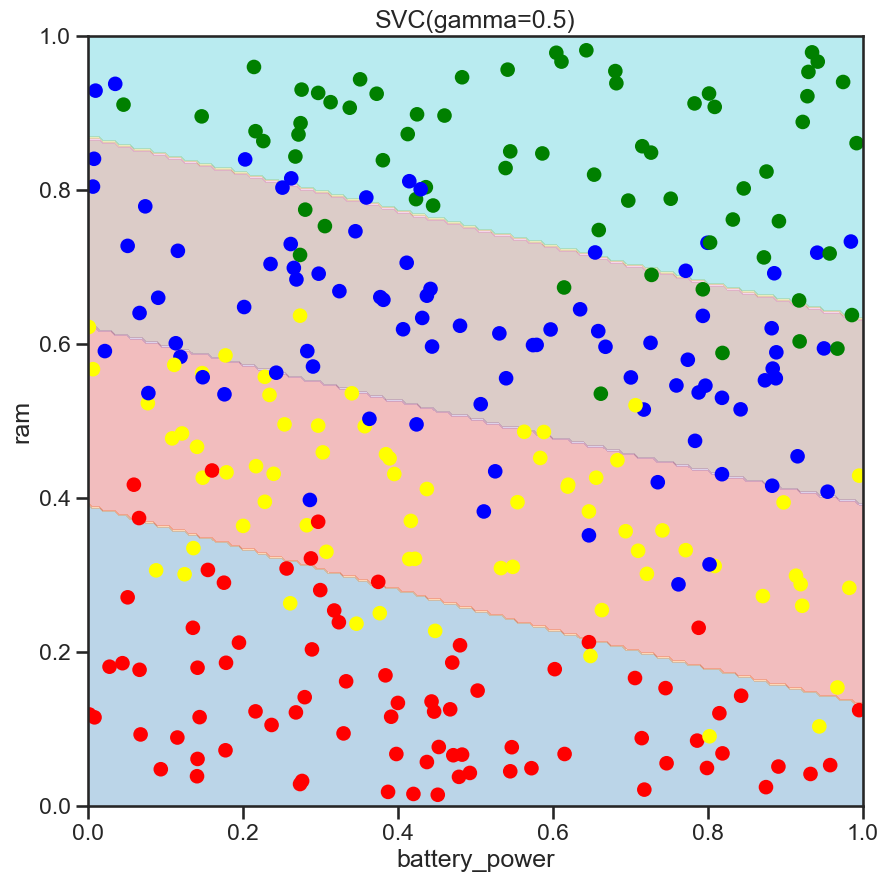

Gamma = 1	Accuracy = 0.8117


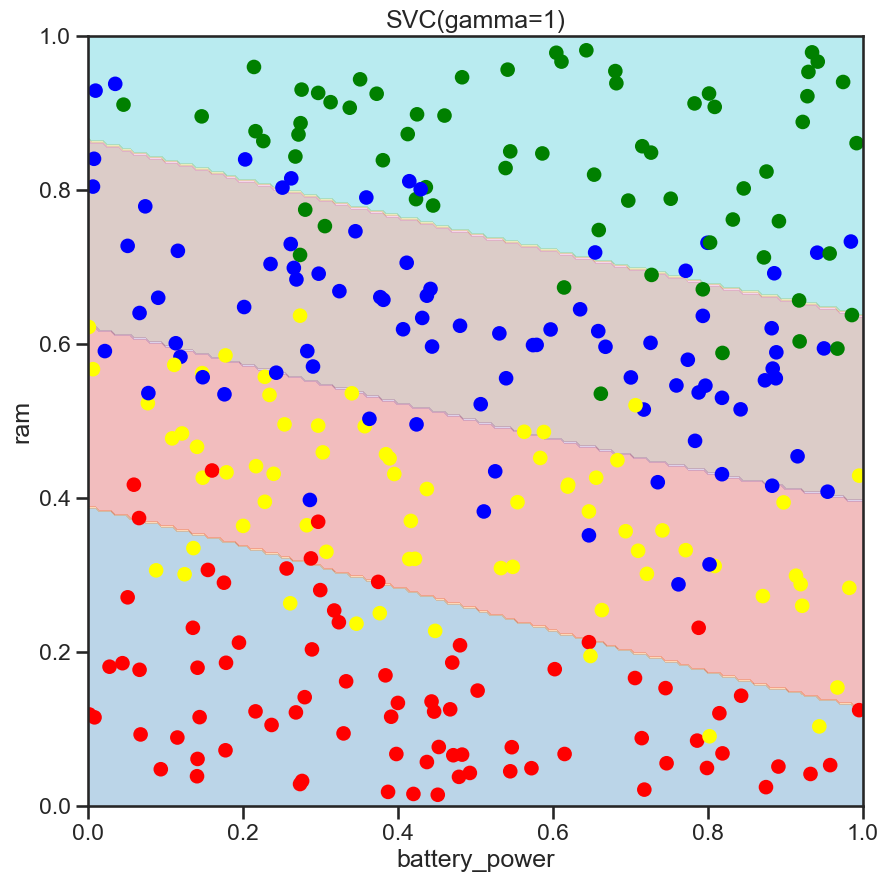

Gamma = 2	Accuracy = 0.8133


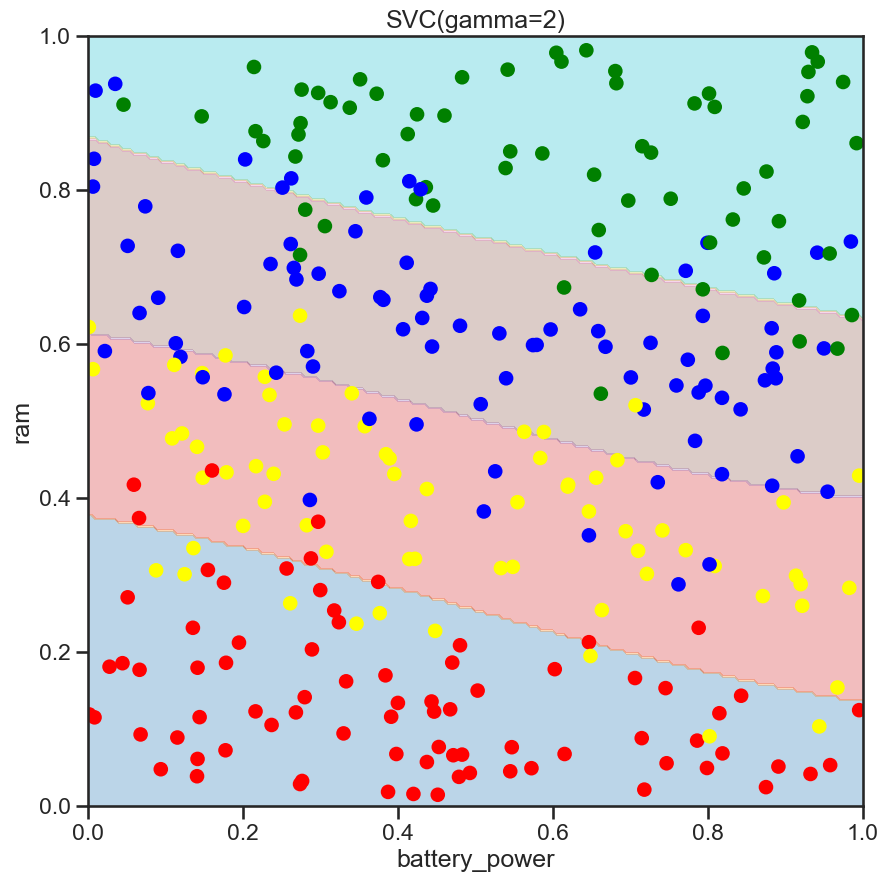

Gamma = 10	Accuracy = 0.8167


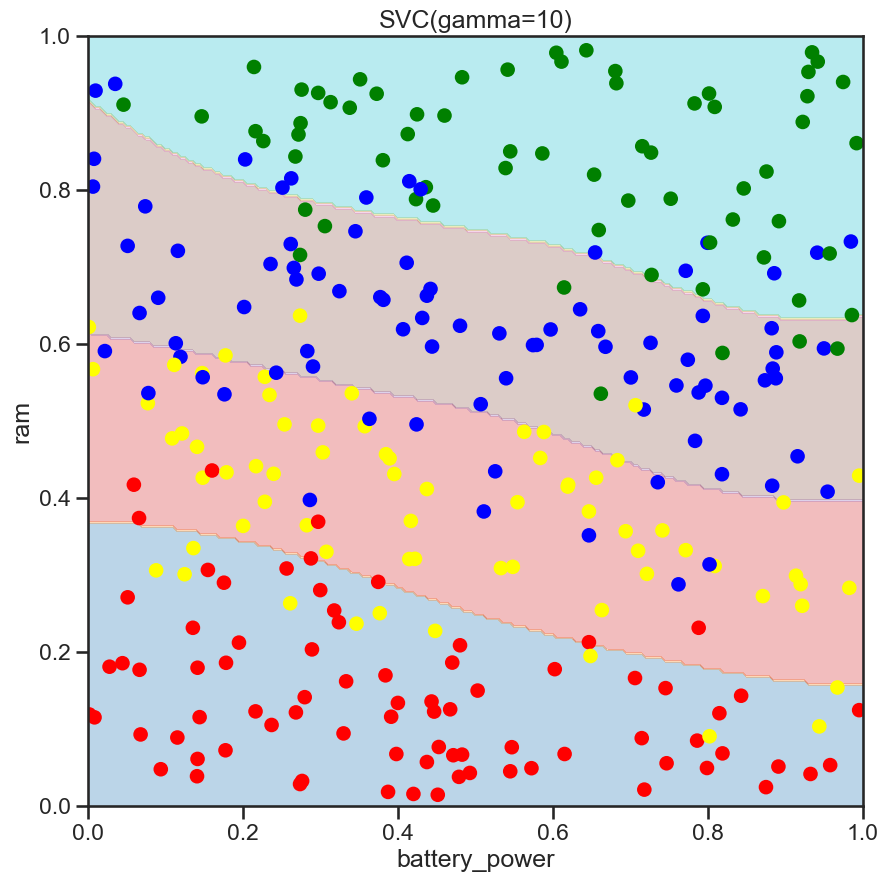

Gamma = 100	Accuracy = 0.8067


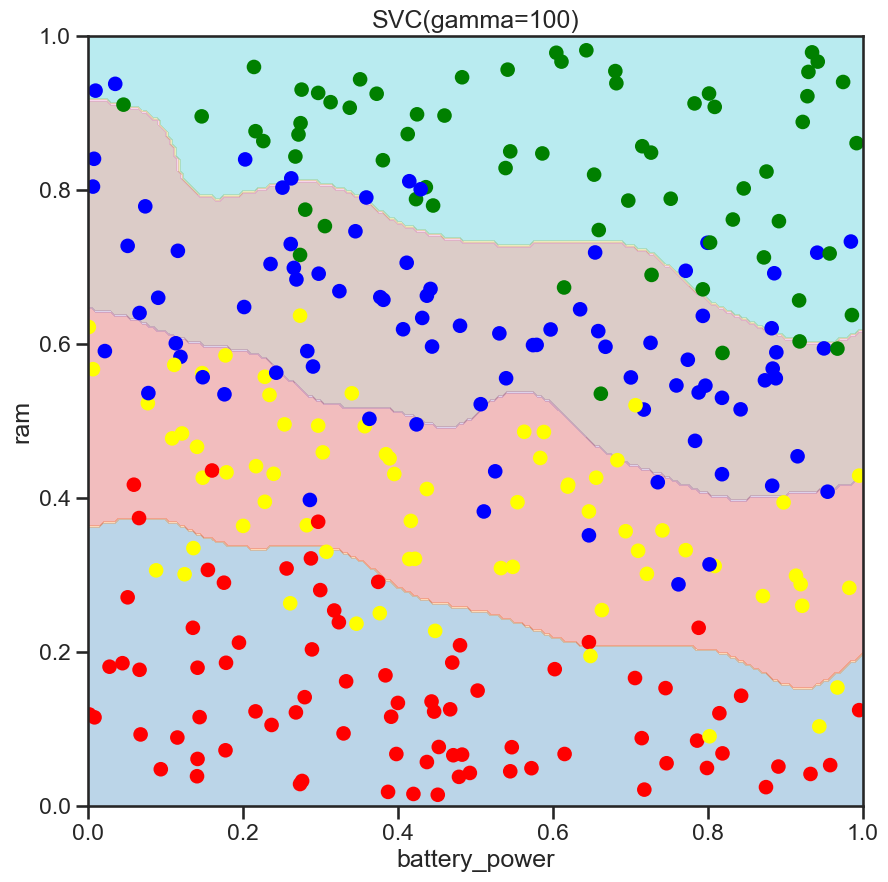

In [105]:
gammas = [.5, 1, 2, 10,100]
results_list = []

for gamma in gammas:
    SVC_Gaussian = SVC(kernel="rbf", gamma=gamma)
    SVC_Gaussian.fit(X_train_s[:, field_indices], y_train)

    y_pred = SVC_Gaussian.predict(X_test_s[:, field_indices])
    results = evaluate_metrics(y_test, y_pred)
    results_list.append(results)
    print(f"Gamma = {gamma}\tAccuracy = {results['accuracy']:.4f}")
    
    X_color = X_train_s_df[fields].sample(300, random_state=random_state)
    y_color = y_train.loc[X_color.index]
    y_color_mapped = y_color.map(color_map)
    
    xx, yy = np.meshgrid(x_axis, y_axis)
    X_grid = pd.DataFrame([xx.ravel(), yy.ravel()]).T
    y_grid_predictions = SVC_Gaussian.predict(X_grid)
    y_grid_predictions = y_grid_predictions.reshape(xx.shape)

    fig, ax = plt.subplots(figsize=(10,10))
    ax.contourf(xx, yy, y_grid_predictions, cmap=plt.cm.tab10, alpha=.3)
    ax.scatter(X_color.iloc[:, 0], X_color.iloc[:, 1], color=y_color_mapped, alpha=1)
    ax.set(
        xlabel = fields[0],
        ylabel = fields[1],
        title = str(SVC_Gaussian))
    plt.show()

Observe the results for the optimal `gamma` value of `100`.

In [107]:
results_list[3]

{'accuracy': 0.8166666666666667,
 'precision': array([0.88198758, 0.78873239, 0.72789116, 0.86      ]),
 'recall': array([0.94666667, 0.74666667, 0.71333333, 0.86      ]),
 'fscore': array([0.91318328, 0.76712329, 0.72053872, 0.86      ])}

### 5.3 SVC Gaussian with GridSearchCV
Create a `gridsearch` object with SVC.

In [109]:
params_grid = {
    "C": [1,10,100],
    "kernel": ["poly", "rbf", "sigmoid"]
}
cv = 5

svc = SVC()
grid_search = GridSearchCV(estimator=svc,
                           param_grid = params_grid,
                           scoring="f1",
                           cv=cv, verbose = 1)

grid_search.fit(X_train_s, y_train.values.ravel())
best_params = grid_search.best_params_
best_params

Fitting 5 folds for each of 9 candidates, totalling 45 fits


{'C': 1, 'kernel': 'poly'}

In [110]:
svc_best = SVC(C=1, kernel="poly")
svc_best.fit(X_train_s, y_train.values.ravel())
y_pred = svc_best.predict(X_test_s)
evaluate_metrics(y_test, y_pred)

{'accuracy': 0.8733333333333333,
 'precision': array([0.93377483, 0.81875   , 0.82068966, 0.92361111]),
 'recall': array([0.94      , 0.87333333, 0.79333333, 0.88666667]),
 'fscore': array([0.93687708, 0.84516129, 0.80677966, 0.9047619 ])}

In [161]:
df.head()

simplified_df = df[["battery_power", "ram", "price_range"]]

X = simplified_df.iloc[:500, :-1].values
y = simplified_df.iloc[:500, -1:].values

under_sampler = RandomUnderSampler(random_state=6767)
X_under, y_under = under_sampler.fit_resample(X, y)

print(f"Dataset resampled shape, X: {X_under.shape}, y:{y_under.shape}")

Dataset resampled shape, X: (452, 2), y:(452,)


In [162]:
scaler = MinMaxScaler()
X_under_s = scaler.fit_transform(X_under)

linear_svm = SVC(C=1, kernel="linear")
linear_svm.fit(X_under, y_under)

,C,1
,kernel,'linear'
,degree,3
,gamma,'scale'
,coef0,0.0
,shrinking,True
,probability,False
,tol,0.001
,cache_size,200
,class_weight,None
,verbose,False


In [163]:
def plot_decision_boundary(X, y, model):
    plt.figure(figsize=(16,12))
    plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Paired, s=60, edgecolor="k")

    ax = plt.gca()
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()

    xx = np.linspace(xlim[0], xlim[1], 30)
    yy = np.linspace(ylim[0], ylim[1], 30)

    YY, XX = np.meshgrid(yy, xx)
    xy = np.vstack([XX.ravel(), YY.ravel()]).T
    Z = model.predict(xy).reshape(XX.shape)

    ax.contour(XX, YY, Z, levels=[0,1,2,3], colors="k", alpha=0.5)
    
    ax.set_xlabel("battery_power")
    ax.set_ylabel("ram")
    ax.set_title("decision boundary for LinearSVC")

    plt.show()

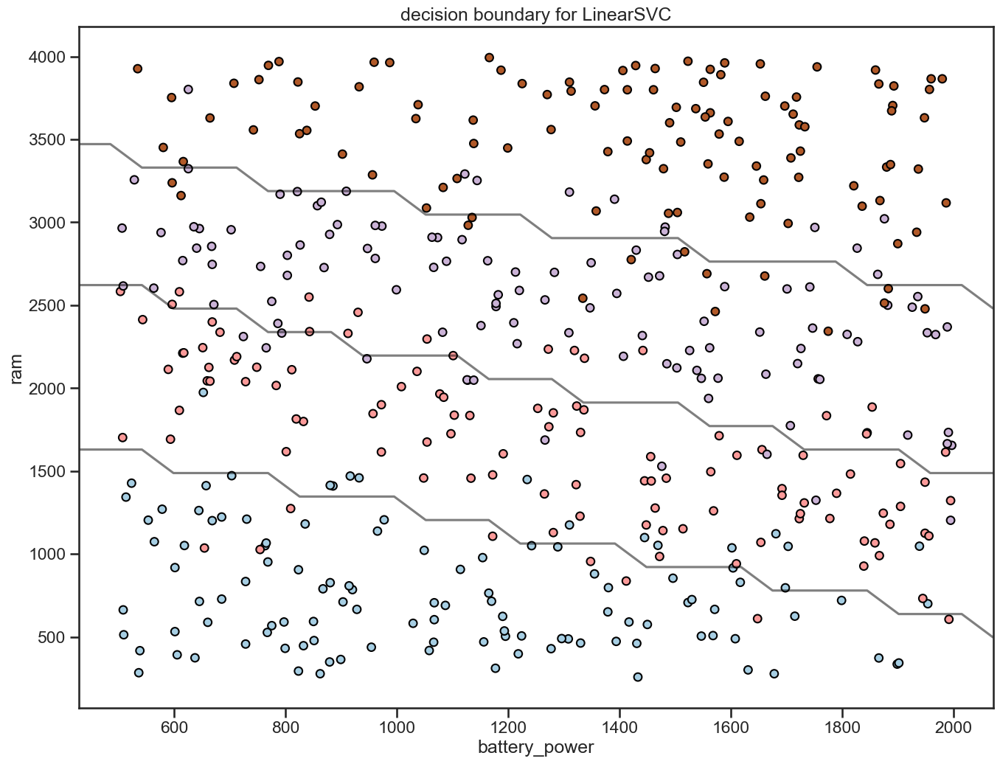

In [164]:
plot_decision_boundary(X_under, y_under, linear_svm)

In [165]:
svm_rbf_kernel = SVC(C=5, kernel="rbf")
svm_rbf_kernel.fit(X_under, y_under)

,C,5
,kernel,'rbf'
,degree,3
,gamma,'scale'
,coef0,0.0
,shrinking,True
,probability,False
,tol,0.001
,cache_size,200
,class_weight,None
,verbose,False


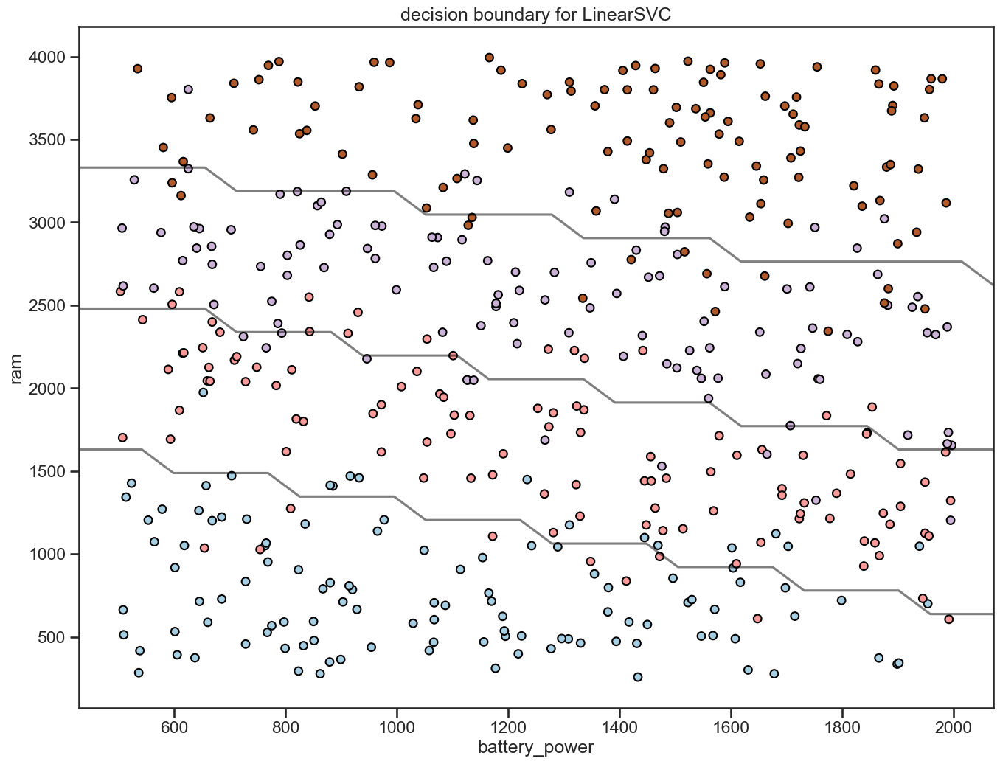

In [166]:
plot_decision_boundary(X_under, y_under, svm_rbf_kernel)

## Decision Trees

In [167]:
strat_shuff_split = StratifiedShuffleSplit(n_splits=1, test_size= 1000, random_state=6767)

feature_cols = [x for x in df.columns if x not in "price_range"]

train_idx, test_idx = next(strat_shuff_split.split(df[feature_cols], df["price_range"]))

X_train = df.loc[train_idx, feature_cols]
y_train = df.loc[train_idx, "price_range"]

X_test = df.loc[test_idx, feature_cols]
y_test = df.loc[test_idx, "price_range"]

y_train.value_counts(normalize=True).sort_index()
y_test.value_counts(normalize=True).sort_index()

price_range
0    0.25
1    0.25
2    0.25
3    0.25
Name: proportion, dtype: float64

In [168]:
dt = DecisionTreeClassifier(random_state=6767)
dt = dt.fit(X_train, y_train)
dt.tree_.node_count, dt.tree_.max_depth

def measure_error(y_test, y_pred, label):
    return pd.Series({"Accuracy": accuracy_score(y_test, y_pred),
                      "Precision": precision_score(y_test, y_pred, average="weighted"),
                      "Recall": recall_score(y_test, y_pred, average="weighted"),
                      "F1": f1_score (y_test, y_pred, average="weighted")},
                      name=label)

y_train_pred = dt.predict(X_train)
y_test_pred = dt.predict(X_test)

train_test_full_error = pd.concat([measure_error(y_train, y_train_pred, "train"),
                                                 measure_error(y_test, y_test_pred, "test")],
                                                 axis=1)

train_test_full_error

,train,test
Accuracy,1.0,0.796000
Precision,1.0,0.798302
Recall,1.0,0.796000
F1,1.0,0.796875


In [169]:
param_grid = {"max_depth": range(1, dt.tree_.max_depth+1, 2),
              "max_features": range(1, len(dt.feature_importances_)+1)}

GR = GridSearchCV(DecisionTreeClassifier(random_state=6767),
                  param_grid=param_grid,
                  scoring="accuracy",
                  n_jobs=-1)

GR = GR.fit(X_train, y_train)

GR.best_estimator_.tree_.node_count, GR.best_estimator_.tree_.max_depth

y_train_pred_gr = GR.predict(X_train)
y_test_pred_gr = GR.predict(X_test)

train_test_gr_error = pd.concat([measure_error(y_train, y_train_pred_gr, "train"),
                                 measure_error(y_test, y_test_pred_gr, "test")],
                                 axis=1)

train_test_gr_error

,train,test
Accuracy,0.955000,0.793000
Precision,0.954963,0.793838
Recall,0.955000,0.793000
F1,0.954957,0.793273


In [170]:
feature_cols = [x for x in df.columns if x != "battery_power"]

X_train = df.loc[train_idx, feature_cols]
y_train = df.loc[train_idx, "battery_power"]

X_test = df.loc[test_idx, feature_cols]
y_test = df.loc[test_idx, "battery_power"]

dtr = DecisionTreeRegressor().fit(X_train, y_train)

param_grid = {"max_depth": range(1, dtr.tree_.max_depth+1, 2),
              "max_features": range(1, len(dtr.feature_importances_)+1)}

gr_bp = GridSearchCV(DecisionTreeRegressor(random_state=6767),
                     param_grid = param_grid,
                     scoring ="neg_mean_squared_error",
                     n_jobs=1)

gr_bp = gr_bp.fit(X_train, y_train)

gr_bp.best_estimator_.tree_.node_count, gr_bp.best_estimator_.tree_.max_depth

(63, 5)

In [171]:
y_train_pred_gr_bp = gr_bp.predict(X_train)
y_test_pred_gr_bp = gr_bp.predict(X_test)

train_test_gr_bp_error = pd.Series({"train": mean_squared_error(y_train, y_train_pred_gr_bp),
                                    "test": mean_squared_error(y_test, y_test_pred_gr_bp)},
                                    name="MSE").to_frame().T

train_test_gr_bp_error

,train,test
MSE,124378.930895,165877.930365


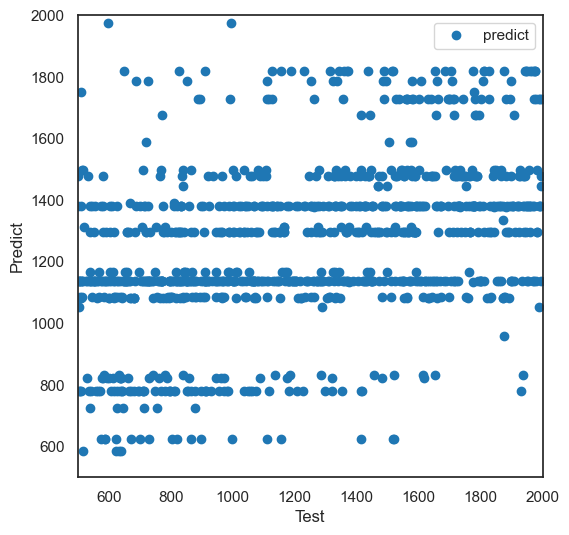

In [ ]:
sns.set_context("notebook")

fig = plt.figure(figsize=(6,6))
ax = plt.axes()

ph_test_predict = pd.DataFrame({"test": y_test.values,
                                "predict": y_test_pred_gr_bp}).set_index("test").sort_index()

ph_test_predict.plot(marker="o", ls="", ax=ax)
ax.set(xlabel="Test", ylabel="Predict", xlim=(500,2000), ylim=(500,2000));


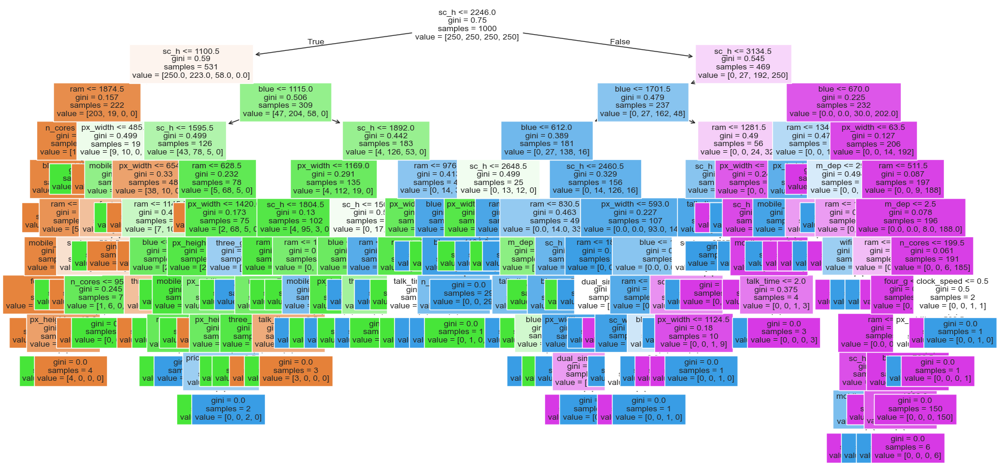

In [173]:
from sklearn import tree
plt.figure(figsize=(20,10))
tree.plot_tree(dt, filled=True, feature_names=feature_cols, fontsize=10)
plt.show()


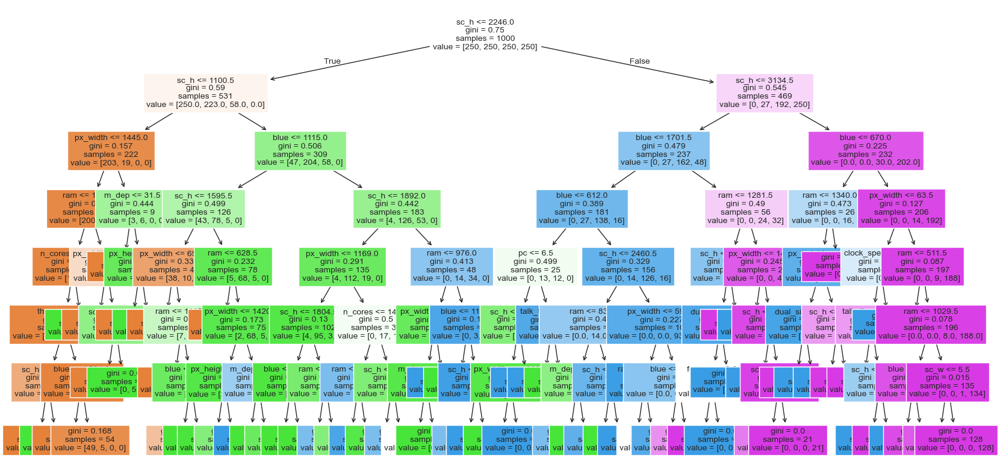

In [174]:
from sklearn import tree
plt.figure(figsize=(20,10))
tree.plot_tree(GR.best_estimator_, filled=True, feature_names=feature_cols, fontsize=10)
plt.show()

In [175]:
X = df.iloc[:, :-1]
y = df.iloc[:, -1:]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=6767)

model = DecisionTreeClassifier(random_state=6767)
model.fit(X_train, y_train.values.ravel())
y_pred = model.predict(X_test)

evaluate_metrics(y_test, y_pred)

{'accuracy': 0.8125,
 'recall': 0.8125,
 'precision': 0.8194929970230477,
 'f1score': 0.8134719078684597}

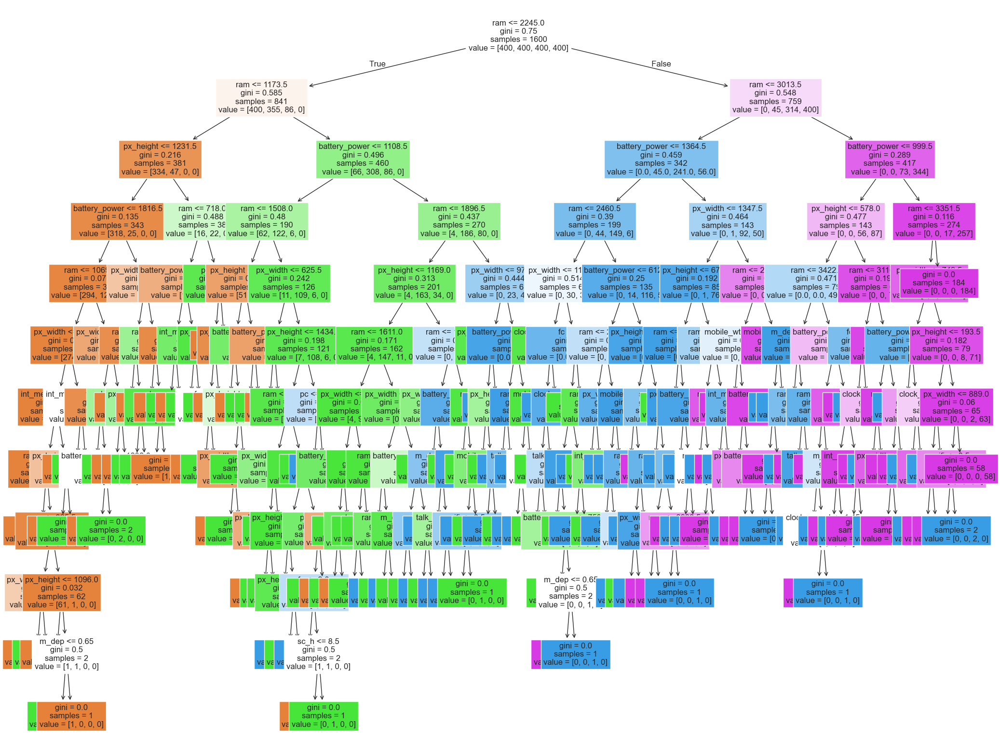

In [176]:
def plot_decision_tree(model, feature_names):
    plt.subplots(figsize=(25,20))
    tree.plot_tree(model,
                   feature_names=feature_names,
                   filled=True,
                   fontsize=12,
                   impurity=True,)
    plt.show()

feature_names = X.columns.values
plot_decision_tree(model, feature_names)

Build simplified decision trees for better, less overfit results.

In [177]:
criterion = "entropy"
max_depth = 10
min_samples_leaf=3
custom_model = DecisionTreeClassifier(criterion=criterion, max_depth=max_depth, min_samples_leaf=min_samples_leaf, random_state=6767)
custom_model.fit(X_train, y_train.values.ravel())
y_pred = custom_model.predict(X_test)
evaluate_metrics(y_test, y_pred)

{'accuracy': 0.8575,
 'recall': 0.8575,
 'precision': 0.8605835932772956,
 'f1score': 0.8578176352944155}

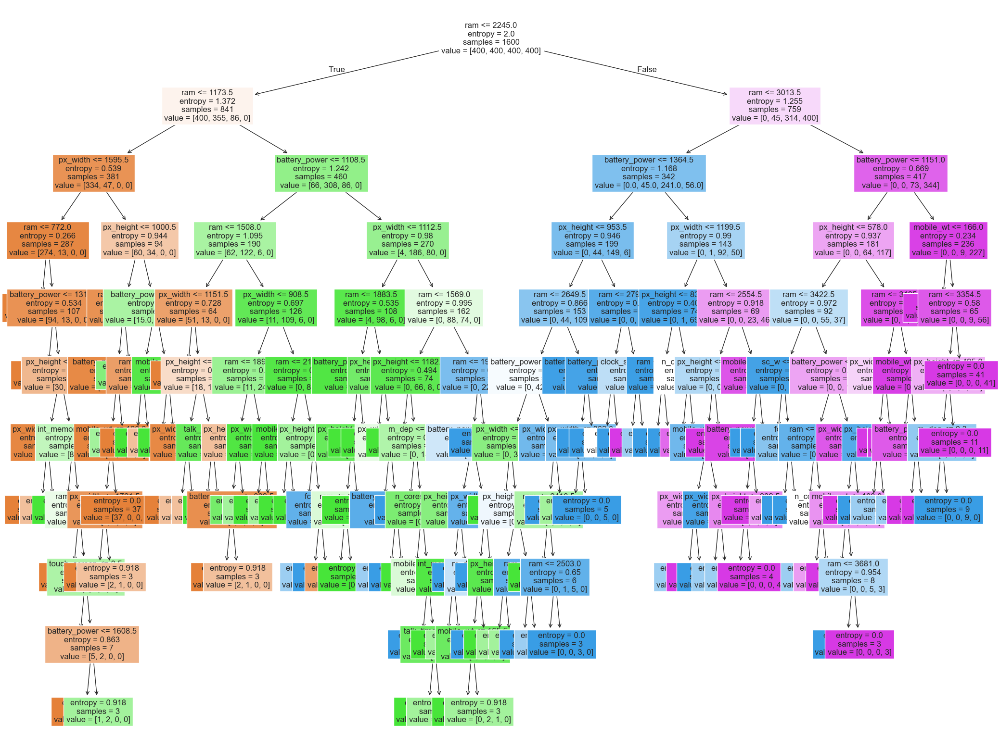

In [178]:
plot_decision_tree(custom_model, feature_names)

In [179]:
criterion = "gini"
max_depth = 15
min_samples_leaf=5
custom_model = DecisionTreeClassifier(criterion=criterion, max_depth=max_depth, min_samples_leaf=min_samples_leaf, random_state=6767)
custom_model.fit(X_train, y_train.values.ravel())
y_pred = custom_model.predict(X_test)
evaluate_metrics(y_test, y_pred)

{'accuracy': 0.8175,
 'recall': 0.8175,
 'precision': 0.8211838972090268,
 'f1score': 0.8186279258132768}

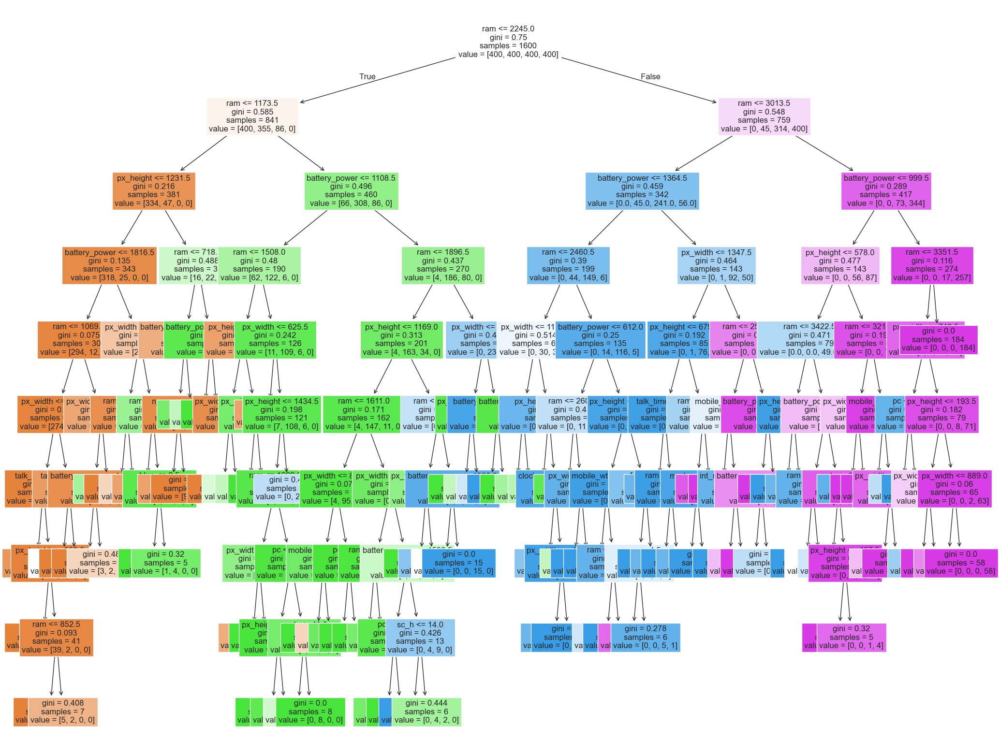

In [180]:
plot_decision_tree(custom_model, feature_names)

In [181]:
params_grid = {
    "criterion": ["gini", "entropy"],
    "max_depth": [5, 10, 15, 20],
    "min_samples_leaf": [1,2,5]
}

model = DecisionTreeClassifier(random_state = 6767)

grid_search = GridSearchCV(estimator = model,
                           param_grid = params_grid,
                           scoring="f1",
                           cv =5, verbose =1)

grid_search.fit(X_train, y_train.values.ravel())
best_params = grid_search.best_params_
best_params

Fitting 5 folds for each of 24 candidates, totalling 120 fits


{'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 1}

In [182]:
criterion = "gini"
max_depth = 5
min_samples_leaf=1
custom_model = DecisionTreeClassifier(criterion=criterion, max_depth=max_depth, min_samples_leaf=min_samples_leaf, random_state=6767)
custom_model.fit(X_train, y_train.values.ravel())
y_pred = custom_model.predict(X_test)
evaluate_metrics(y_test, y_pred)

{'accuracy': 0.82,
 'recall': 0.82,
 'precision': 0.8231091064347308,
 'f1score': 0.8204797640705768}

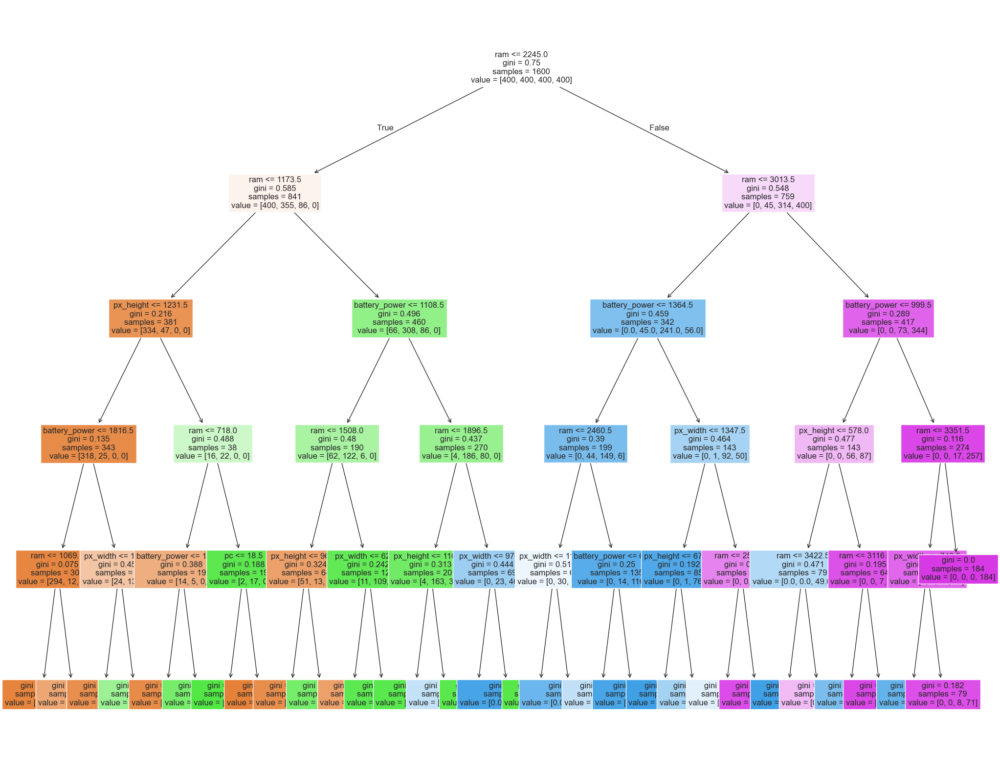

In [183]:
plot_decision_tree(custom_model, feature_names)

## Bagging

In [184]:
def get_accuracy(X_train, X_test, y_train, y_test, model):
    return {"Test Accuracy": metrics.accuracy_score(y_test, model.predict(X_test)),
            "Train Accuracy":metrics.accuracy_score(y_train, model.predict(X_train))}

def get_correlation(X_test, y_test, model):
    n_estimators = len(model.estimators_)
    prediction = np.zeros((y_test.shape[0], n_estimators))
    predictions = pd.DataFrame({"estimator "+str(n+1):[] for n in range(n_estimators)})

    for key, model in zip(predictions.keys(), model.estimators_):
        predictions[key]=model.predict(X_test.to_numpy())

    corr=predictions.corr()
    print("Average correlation between predictors: ", corr.mean().mean()-1/n_estimators)
    return corr

Random forest is similar to bagging as they both use model ensembles to make predictions. However, Random forest does not suffer from overfitting.

In [185]:
X = df.iloc[:, :-1]
y = df["price_range"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=6767)
print("Train set", X_train.shape, y_train.shape)
print("Test set", X_test.shape, y_test.shape)

Train set (1400, 20) (1400,)
Test set (600, 20) (600,)


In [186]:
n_estimators=20
Bag = BaggingClassifier(estimator=DecisionTreeClassifier(criterion="entropy",
                                                              max_depth=4,
                                                              random_state=6767),
                                                              n_estimators=n_estimators,
                                                              random_state=6767,
                                                              bootstrap=True)

Bag.fit(X_train, y_train)

,estimator,DecisionTreeC...om_state=6767)
,n_estimators,20
,max_samples,1.0
,max_features,1.0
,bootstrap,True
,bootstrap_features,False
,oob_score,False
,warm_start,False
,n_jobs,None
,random_state,6767
,verbose,0


In [187]:
Bag.predict(X_test).shape

(600,)

In [188]:
print(get_accuracy(X_train, X_test, y_train, y_test, Bag))
get_correlation(X_test, y_test, Bag).style.background_gradient(cmap="coolwarm")

{'Test Accuracy': 0.81, 'Train Accuracy': 0.8635714285714285}
Average correlation between predictors:  0.8750446863968558


,estimator 1,estimator 2,estimator 3,estimator 4,estimator 5,estimator 6,estimator 7,estimator 8,estimator 9,estimator 10,estimator 11,estimator 12,estimator 13,estimator 14,estimator 15,estimator 16,estimator 17,estimator 18,estimator 19,estimator 20
estimator 1,1.000000,0.900017,0.908755,0.882547,0.884183,0.900949,0.903424,0.874826,0.881880,0.898078,0.888099,0.858076,0.904539,0.888692,0.928438,0.883021,0.913061,0.902116,0.892150,0.896802
estimator 2,0.900017,1.000000,0.953529,0.936291,0.940836,0.948914,0.933012,0.905860,0.927396,0.915250,0.965154,0.897366,0.945808,0.921065,0.939734,0.909731,0.932637,0.940116,0.962115,0.936548
estimator 3,0.908755,0.953529,1.000000,0.943331,0.939859,0.939872,0.953635,0.898397,0.930068,0.929492,0.934740,0.883645,0.922013,0.915647,0.945936,0.924627,0.944774,0.957520,0.928644,0.959095
estimator 4,0.882547,0.936291,0.943331,1.000000,0.958567,0.947682,0.937675,0.914290,0.935102,0.918015,0.948628,0.913297,0.925058,0.926326,0.918466,0.913075,0.939433,0.930511,0.941929,0.939219
estimator 5,0.884183,0.940836,0.939859,0.958567,1.000000,0.934320,0.945189,0.905440,0.927947,0.935114,0.944070,0.894914,0.926539,0.922472,0.926049,0.936585,0.932709,0.952570,0.959553,0.949176
estimator 6,0.900949,0.948914,0.939872,0.947682,0.934320,1.000000,0.932937,0.920119,0.920953,0.912381,0.940819,0.919123,0.935636,0.897479,0.954169,0.893506,0.932613,0.935082,0.939169,0.934805
estimator 7,0.903424,0.933012,0.953635,0.937675,0.945189,0.932937,1.000000,0.889396,0.926944,0.945052,0.930538,0.883622,0.948747,0.918610,0.928096,0.908979,0.927990,0.955013,0.944266,0.944783
estimator 8,0.874826,0.905860,0.898397,0.914290,0.905440,0.920119,0.889396,1.000000,0.893069,0.905118,0.912599,0.901106,0.902098,0.912157,0.909501,0.891882,0.922510,0.911758,0.906571,0.904586
estimator 9,0.881880,0.927396,0.930068,0.935102,0.927947,0.920953,0.926944,0.893069,1.000000,0.911047,0.939623,0.917896,0.905394,0.894827,0.905829,0.886274,0.914278,0.926350,0.931316,0.910456
estimator 10,0.898078,0.915250,0.929492,0.918015,0.935114,0.912381,0.945052,0.905118,0.911047,1.000000,0.906787,0.874175,0.915731,0.908816,0.923621,0.926733,0.921062,0.944936,0.918618,0.924045


In [189]:
feature_cols = [x for x in df.columns if x != "price_range"]

strat_shuff_split = StratifiedShuffleSplit(n_splits=1, test_size=1500, random_state=6767)

train_idx, test_idx = next(strat_shuff_split.split(df[feature_cols], df["price_range"]))

X_train = df.loc[train_idx, feature_cols]
y_train = df.loc[train_idx, "price_range"]

X_test = df.loc[test_idx, feature_cols]
y_test = df.loc[test_idx, "price_range"]

y_train.value_counts(normalize=True)

price_range
1    0.25
0    0.25
3    0.25
2    0.25
Name: proportion, dtype: float64

In [190]:
y_test.value_counts(normalize=True)

price_range
2    0.25
1    0.25
3    0.25
0    0.25
Name: proportion, dtype: float64

In [191]:
rfc = RandomForestClassifier(oob_score=True,
                             random_state = 6767,
                             warm_start=True,
                             n_jobs=1)

oob_list=list()
for n_trees in [15, 20, 30, 40, 50, 100, 150, 200, 300, 400]:
    rfc.set_params(n_estimators=n_trees)
    rfc.fit(X_train, y_train)
    oob_error = 1 - rfc.oob_score_
    oob_list.append(pd.Series({"n_trees": n_trees, "oob": oob_error}))

rf_oob_df = pd.concat(oob_list, axis=1).T.set_index("n_trees")
rf_oob_df


,oob
n_trees,
15.0,0.292
20.0,0.248
30.0,0.224
40.0,0.212
50.0,0.202
100.0,0.200
150.0,0.168
200.0,0.168
300.0,0.158


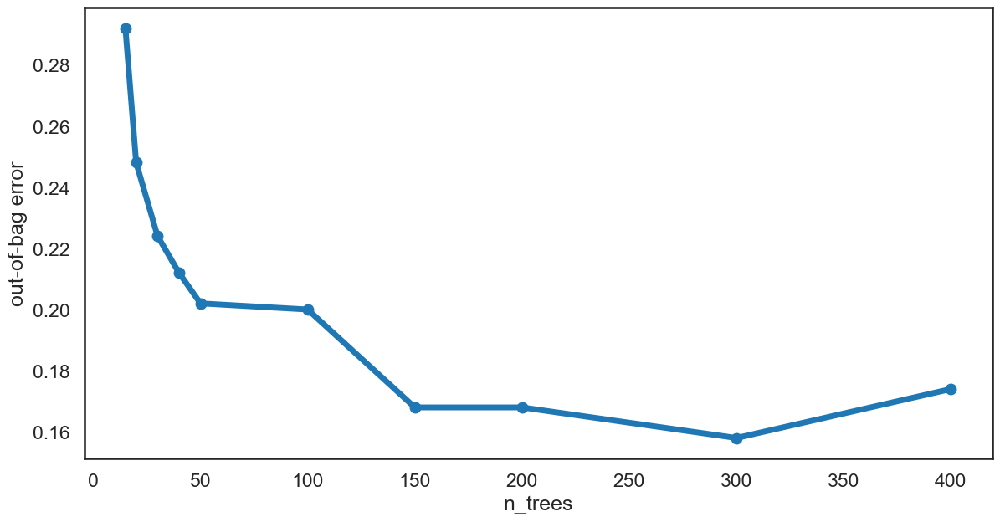

In [ ]:
sns.set_style("white")

ax = rf_oob_df.plot(legend=False, marker="o", figsize=(14,7), linewidth=5)
ax.set(ylabel="out-of-bag error");

## Random Forest

In [193]:
n_estimators=20
M_features = X.shape[1]
max_features = round(np.sqrt(M_features))-1
max_features

3

In [194]:
y_test

934     2
1511    1
402     3
986     0
1820    0
       ..
1131    2
124     2
1541    3
1906    1
768     3
Name: price_range, Length: 1500, dtype: int64

In [195]:
rvc = RandomForestClassifier(max_features = max_features, n_estimators=n_estimators, random_state=6767)
rvc.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, rvc))

{'Test Accuracy': 0.7553333333333333, 'Train Accuracy': 1.0}


In [196]:
get_correlation(X_test, y_test, rvc).style.background_gradient(cmap="coolwarm")

Average correlation between predictors:  0.3639167061520631


,estimator 1,estimator 2,estimator 3,estimator 4,estimator 5,estimator 6,estimator 7,estimator 8,estimator 9,estimator 10,estimator 11,estimator 12,estimator 13,estimator 14,estimator 15,estimator 16,estimator 17,estimator 18,estimator 19,estimator 20
estimator 1,1.000000,0.132197,0.477920,0.279369,0.335463,0.348807,0.252077,0.432642,0.296406,0.238512,0.473194,0.480885,0.483550,0.340310,0.310327,0.266669,0.391187,0.457710,0.298764,0.451822
estimator 2,0.132197,1.000000,0.194450,0.134979,0.173366,0.185589,0.170063,0.184187,0.113506,0.101079,0.209287,0.207654,0.212944,0.167255,0.196337,0.171784,0.202633,0.223276,0.264398,0.216376
estimator 3,0.477920,0.194450,1.000000,0.391982,0.518733,0.454501,0.366303,0.585056,0.388526,0.308649,0.673012,0.699733,0.737707,0.527604,0.486623,0.363694,0.580718,0.729746,0.467985,0.660380
estimator 4,0.279369,0.134979,0.391982,1.000000,0.325799,0.289078,0.250505,0.328224,0.211806,0.189982,0.383930,0.422374,0.413066,0.306804,0.271940,0.207934,0.337625,0.416492,0.300138,0.354075
estimator 5,0.335463,0.173366,0.518733,0.325799,1.000000,0.362283,0.243804,0.482984,0.303302,0.293265,0.520426,0.525153,0.522134,0.366302,0.328303,0.288170,0.415971,0.506137,0.363643,0.470712
estimator 6,0.348807,0.185589,0.454501,0.289078,0.362283,1.000000,0.237536,0.379777,0.289002,0.153216,0.465443,0.490423,0.482592,0.339415,0.324908,0.250080,0.490564,0.498478,0.320081,0.457814
estimator 7,0.252077,0.170063,0.366303,0.250505,0.243804,0.237536,1.000000,0.323013,0.206328,0.198000,0.329689,0.441641,0.357736,0.320931,0.311037,0.162556,0.285992,0.352238,0.261617,0.348688
estimator 8,0.432642,0.184187,0.585056,0.328224,0.482984,0.379777,0.323013,1.000000,0.327585,0.305941,0.554051,0.594746,0.581915,0.481460,0.394970,0.354221,0.505884,0.562862,0.441509,0.560735
estimator 9,0.296406,0.113506,0.388526,0.211806,0.303302,0.289002,0.206328,0.327585,1.000000,0.152326,0.371524,0.399034,0.391051,0.300518,0.259383,0.190125,0.324382,0.382401,0.299034,0.390847
estimator 10,0.238512,0.101079,0.308649,0.189982,0.293265,0.153216,0.198000,0.305941,0.152326,1.000000,0.306867,0.298346,0.313279,0.221020,0.242064,0.217109,0.217848,0.328581,0.237291,0.298939


In [197]:
rfc = RandomForestClassifier()
rfc.get_params().keys()

param_grid = {"n_estimators": [2*n+1 for n in  range(20)],
              "max_depth": [2&n+1 for n in range(10)],
              "max_features": ["auto", "sqrt", "log2"]}

search = GridSearchCV(estimator=rfc, param_grid=param_grid, scoring="accuracy")
search.fit(X_train, y_train)

,estimator,RandomForestClassifier()
,param_grid,"{'max_depth': [0, 2, ...], 'max_features': ['auto', 'sqrt', ...], 'n_estimators': [1, 3, ...]}"
,scoring,'accuracy'
,n_jobs,None
,refit,True
,cv,None
,verbose,0
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,n_estimators,37


In [198]:
search.best_score_

np.float64(0.758)

In [199]:
search.best_params_

{'max_depth': 2, 'max_features': 'sqrt', 'n_estimators': 37}

In [200]:
print(get_accuracy(X_train, X_test, y_train, y_test, search.best_estimator_))

{'Test Accuracy': 0.7233333333333334, 'Train Accuracy': 0.814}


### Extra Trees

In [201]:
et = ExtraTreesClassifier(oob_score=True,
                          random_state=6767,
                          warm_start=True,
                          bootstrap=True,
                          n_jobs=-1)
oob_list = list()

for n_trees in [15, 20, 30, 40, 50, 100, 150, 200, 300, 400]:
        et.set_params(n_estimators=n_trees)
        et.fit(X_train, y_train)
        oob_error = 1 - et.oob_score_
        oob_list.append(pd.Series({"n_trees": n_trees, "oob": oob_error}))

et_oob_df = pd.concat(oob_list, axis=1).T.set_index("n_trees")
et_oob_df

,oob
n_trees,
15.0,0.416
20.0,0.350
30.0,0.330
40.0,0.310
50.0,0.304
100.0,0.254
150.0,0.214
200.0,0.216
300.0,0.208


In [202]:
oob_df = pd.concat([rf_oob_df.rename(columns={"oob": "RandomForest"}),
                    et_oob_df.rename(columns={"oob": "ExtraTrees"})], axis=1)

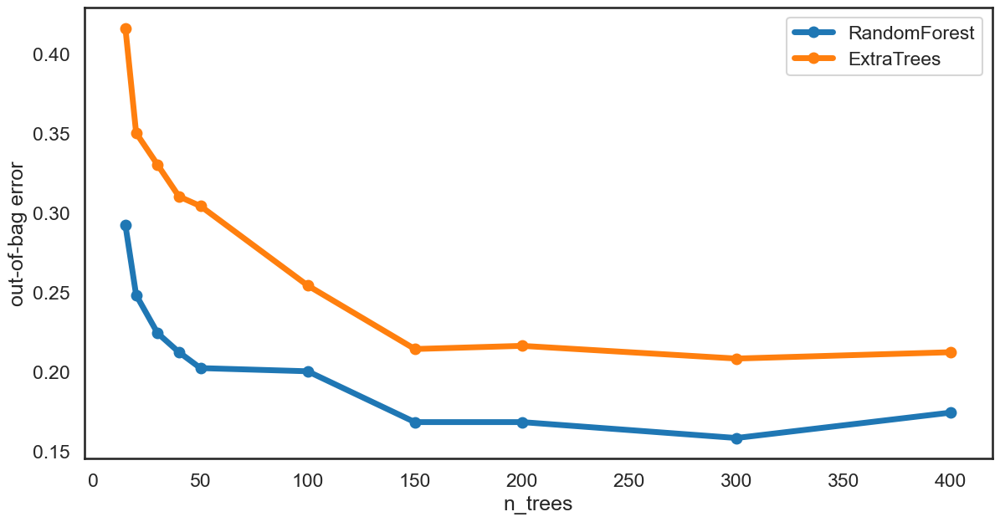

In [ ]:
sns.set_context("talk")

ax = oob_df.plot(marker="o", figsize=(14,7), linewidth=5)
ax.set(ylabel="out-of-bag error");

In [204]:
model = rvc.set_params(n_estimators=100)
y_pred = model.predict(X_test)
y_proba = model.predict_proba(X_test)

cr = classification_report(y_test, y_pred)
print(cr)

score_df = pd.DataFrame({"accuracy": accuracy_score(y_test, y_pred),
                         "precision": precision_score(y_test, y_pred, average="weighted"),
                         "recall": recall_score(y_test, y_pred, average="weighted"),
                         "f1": f1_score(y_test, y_pred, average="weighted"),
                         "auc": roc_auc_score(y_test, y_proba, multi_class="ovr", average="weighted")},
                         index=pd.Index([0]))
print(score_df)

              precision    recall  f1-score   support

           0       0.83      0.89      0.86       375
           1       0.70      0.63      0.67       375
           2       0.66      0.65      0.66       375
           3       0.81      0.85      0.83       375

    accuracy                           0.76      1500
   macro avg       0.75      0.76      0.75      1500
weighted avg       0.75      0.76      0.75      1500

   accuracy  precision    recall        f1       auc
0  0.755333   0.751528  0.755333  0.752614  0.915846


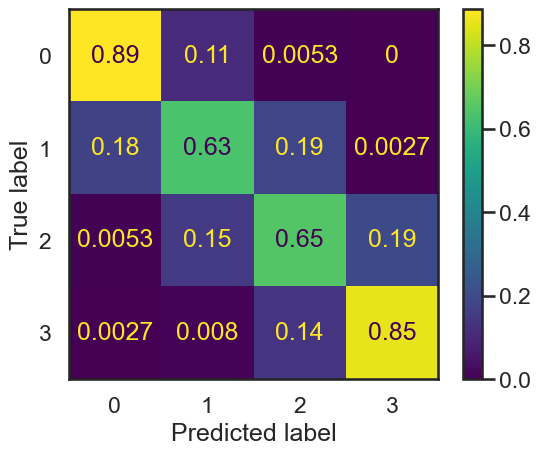

In [ ]:
confus_mat = confusion_matrix(y_test, y_pred, normalize="true")
confus_mat_disp = ConfusionMatrixDisplay(confusion_matrix=confus_mat, display_labels=model.classes_)
confus_mat_disp.plot()
plt.show()

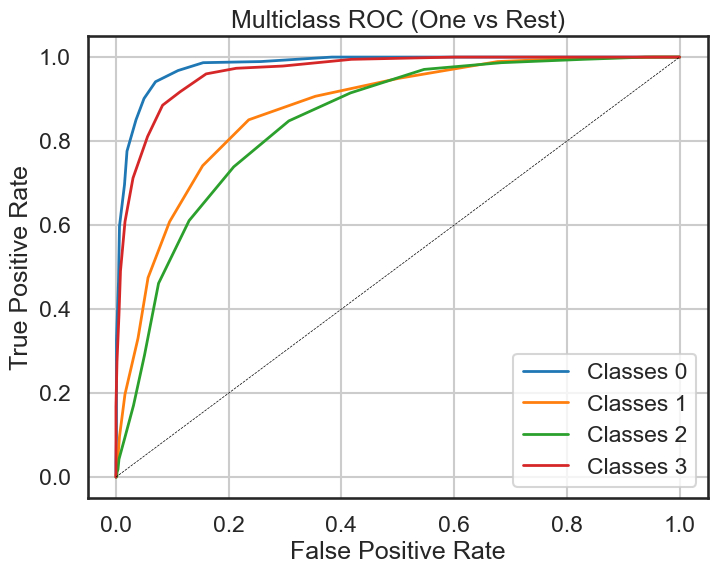

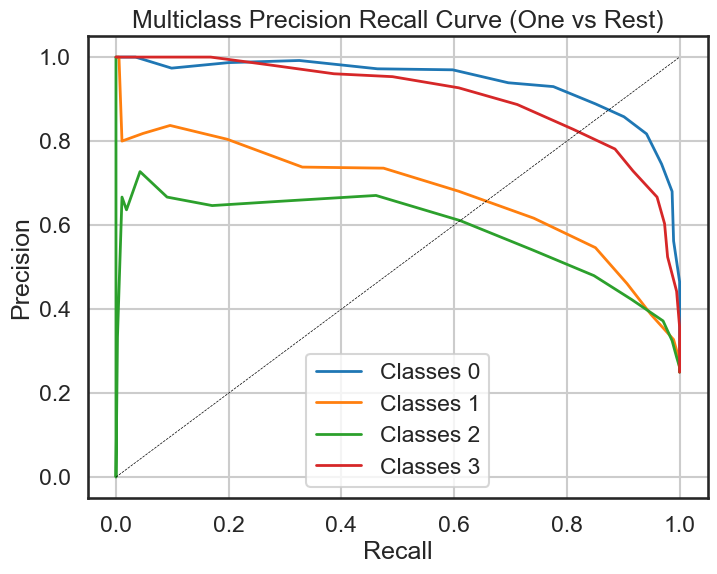

In [ ]:
y_prob = model.predict_proba(X_test)

classes = np.unique(y_test)
y_test_bin = label_binarize(y_test, classes=classes)
plt.figure(figsize=(8,6))

for i, cls in enumerate(classes):
    fpr, tpr, _ = roc_curve(y_test_bin[:, i], y_prob[:, i])
    plt.plot(fpr, tpr, lw=2, label=f"Classes {cls}")

plt.plot([0,1], [0,1], "k--", lw=0.5)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Multiclass ROC (One vs Rest)")
plt.legend()
plt.grid(True)
plt.show();

plt.figure(figsize=(8,6))

for i, cls in enumerate(classes):
    precision, recall, _ = precision_recall_curve(y_test_bin[:, i], y_prob[:, i])
    plt.plot(recall, precision, lw=2, label=f"Classes {cls}")

plt.plot([0,1], [0,1], "k--", lw=0.5)
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Multiclass Precision Recall Curve (One vs Rest)")
plt.legend()
plt.grid(True)
plt.show();


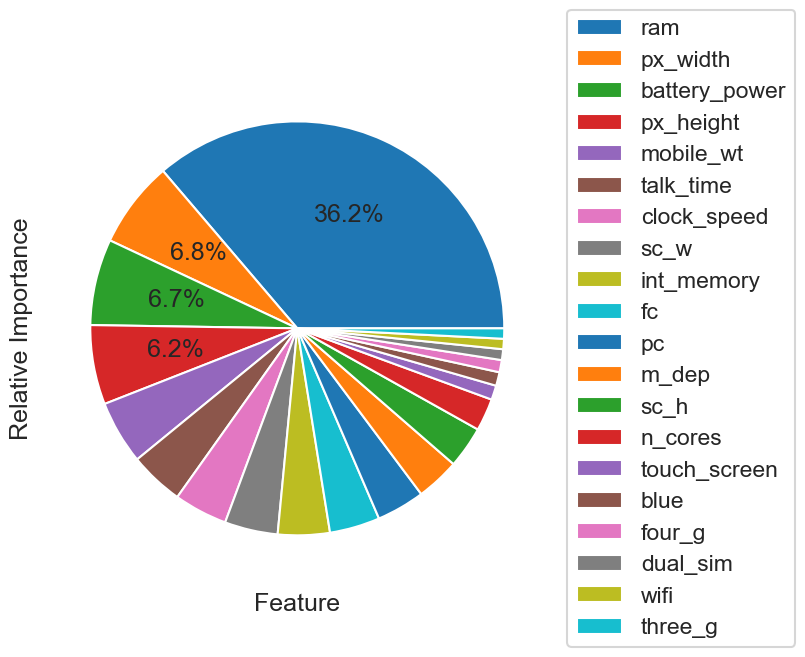

In [207]:
feature_imp = pd.Series(model.feature_importances_, index=feature_cols).sort_values(ascending=False)

fig, ax = plt.subplots(figsize=(16,6))
ax.pie(feature_imp, labels=None, autopct=lambda pct: "{:1.1f}%".format(pct) if pct>5.5 else "")
ax.set(ylabel="Relative Importance")
ax.set(xlabel="Feature")

plt.tight_layout()

plt.legend(loc="center left", bbox_to_anchor=(1,0.5), labels=feature_imp.index)
plt.show()

## Bootstrap Aggregating (Bagging)

### Boostrap Sampling

Boostrap sampling is a method that draws sample data repeatedly with replacement from a data source to estimate a model parameter.

In [208]:
df[0:5]

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


In [209]:
resample(df[0:5])

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2


In [210]:
# Create visualizations of decision trees
def plot_tree(model, filename= "tree.png"):
    dot_data = StringIO()

    featureNames = feature_cols
    out = tree.export_graphviz(model, feature_names=featureNames, out_file=dot_data, class_names=["0","1","2","3"], filled=True, special_characters=True, rotate=False)
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
    graph.write_png(filename)
    img = mpimg.imread(filename)
    plt.figure(figsize=(100,200))
    plt.imshow(img, interpolation="nearest")

# Create a graph of training accuacy vs how many estimators a Bagging Classifier uses

def get_accuracy_bag(X, y, title, times=20, xlabel="Number Estimators"):
    N_estimators = [n for n in range (1,70)]
    times = 20
    train_acc = np.zeros((times, len(N_estimators)))
    test_acc = np.zeros((times, len(N_estimators)))

    train_time = np.zeros((times, len (N_estimators)))
    test_time = np.zeros((times, len(N_estimators)))

    for n in tqdm(range(times)):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
        for n_estimators in N_estimators:
            Bag = BaggingClassifier(estimator = DecisionTreeClassifier(criterion="entropy", max_depth=10), n_estimators=n_estimators, bootstrap=True, random_state=6767)
            Bag.fit(X_train, y_train)

            Accuracy = get_accuracy(X_train, X_test, y_train, y_test, Bag)

            train_acc[n, n_estimators-1] = Accuracy["Train Accuracy"]
            test_acc[n, n_estimators-1] = Accuracy["Test Accuracy"]

    fig, ax1 = plt.subplots()

    ax2 = ax1.twinx()
    ax1.plot(train_acc.mean(axis=0))
    ax2.plot(test_acc.mean(axis=0), c="r")
    ax1.set_xlabel(xlabel)
    ax1.set_ylabel("Training Accuracy", color="b")
    ax2.set_ylabel("Testing Accuracy", color="r")
    plt.title(title)
    plt.show()


In [211]:
max_depth = 5
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=10)
Tree = DecisionTreeClassifier(criterion="entropy", max_depth=max_depth, random_state=6767)
Tree.fit(X_train, y_train)

,criterion,'entropy'
,splitter,'best'
,max_depth,5
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,None
,random_state,6767
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,class_weight,None


In [212]:
y_pred = Tree.predict(X_test)
y_pred

array([3, 3, 1, 3, 1, 3, 2, 3, 1, 3, 2, 3, 0, 1, 0, 3, 1, 3, 2, 2, 3, 2,
       0, 1, 0, 0, 2, 3, 1, 1, 2, 0, 3, 2, 1, 2, 1, 1, 2, 0, 3, 2, 3, 0,
       1, 3, 1, 0, 1, 2, 1, 3, 2, 2, 2, 3, 1, 3, 0, 0, 1, 1, 0, 0, 3, 0,
       1, 0, 2, 2, 2, 1, 1, 1, 3, 1, 3, 3, 2, 1, 3, 0, 1, 0, 1, 3, 1, 3,
       2, 3, 1, 3, 3, 3, 3, 1, 0, 1, 1, 1, 3, 0, 1, 2, 1, 3, 2, 1, 2, 1,
       2, 0, 3, 1, 2, 1, 1, 1, 3, 0, 1, 1, 3, 1, 1, 3, 1, 3, 1, 0, 3, 3,
       3, 1, 2, 0, 0, 3, 3, 2, 3, 0, 3, 2, 0, 2, 3, 1, 2, 1, 1, 0, 0, 1,
       1, 1, 0, 0, 3, 1, 1, 2, 3, 3, 2, 1, 1, 1, 2, 1, 3, 3, 3, 3, 0, 2,
       3, 2, 1, 3, 1, 3, 1, 3, 3, 0, 2, 3, 0, 3, 1, 2, 1, 3, 1, 0, 0, 0,
       0, 3, 1, 2, 3, 3, 1, 1, 1, 1, 3, 0, 2, 1, 1, 3, 3, 1, 3, 1, 3, 1,
       3, 2, 0, 3, 0, 1, 2, 2, 1, 1, 1, 1, 1, 3, 0, 1, 0, 2, 0, 3, 1, 2,
       1, 1, 1, 3, 2, 3, 0, 3, 1, 1, 0, 3, 2, 1, 3, 1, 1, 3, 3, 1, 2, 1,
       3, 2, 3, 0, 2, 2, 3, 2, 0, 3, 0, 3, 1, 1, 2, 0, 3, 3, 0, 1, 1, 1,
       3, 0, 0, 1, 1, 0, 3, 2, 2, 1, 3, 0, 0, 3, 1,

In [213]:
get_accuracy(X_train, X_test, y_train, y_test, Tree)

{'Test Accuracy': 0.795, 'Train Accuracy': 0.8871428571428571}

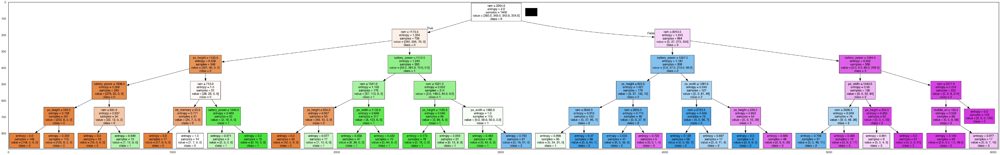

In [214]:
plot_tree(filename = "tree.png", model=Tree)

{'Test Accuracy': 0.8166666666666667, 'Train Accuracy': 0.8885714285714286}


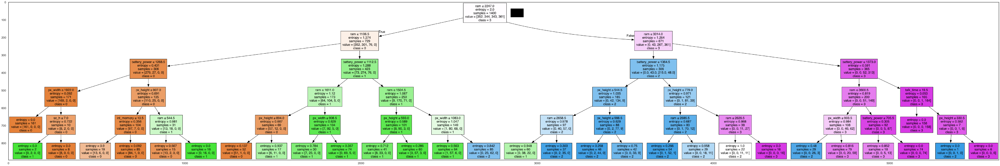

In [215]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size =0.3, random_state=6767)
Tree = DecisionTreeClassifier(criterion="entropy", max_depth = max_depth, random_state=6767)
Tree.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, Tree))
plot_tree(filename = "tree1.png", model=Tree)

{'Test Accuracy': 0.8116666666666666, 'Train Accuracy': 0.8564285714285714}


100%|██████████| 20/20 [03:38<00:00, 10.95s/it]


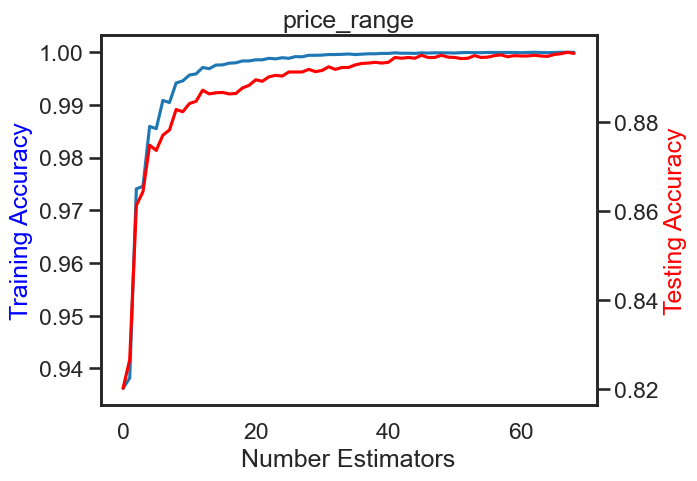

In [216]:
Bag = BaggingClassifier(estimator=DecisionTreeClassifier(criterion="entropy", max_depth=4, random_state=6767), n_estimators=30, random_state=6767, bootstrap=True)
Bag.fit(X_train, y_train)
Bag.predict(X_test)

print(get_accuracy(X_train, X_test, y_train, y_test, Bag))

get_accuracy_bag(X, y, "price_range")

Bagging does not improve results if the model has low variance. Consider the SVM.

In [217]:
clf = SVC(kernel="linear", gamma="scale")
clf.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, clf))

{'Test Accuracy': 0.955, 'Train Accuracy': 0.9978571428571429}


In [218]:
Bag = BaggingClassifier (estimator=SVC(kernel="linear", gamma="scale"), n_estimators=10, random_state=6767, bootstrap=True)
Bag.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, Bag))

{'Test Accuracy': 0.9616666666666667, 'Train Accuracy': 0.9992857142857143}


In [219]:
param_grid = {"n_estimators": [2*n+1 for n in range(20)],
              "estimator__max_depth": [2*n+1 for n in range(10)]}

Bag = BaggingClassifier(estimator = DecisionTreeClassifier(),
                       random_state=6767, bootstrap=True)

search = GridSearchCV(estimator=Bag, param_grid=param_grid, scoring="accuracy", cv=3)

search.fit(X_train, y_train)

,estimator,BaggingClassi...om_state=6767)
,param_grid,"{'estimator__max_depth': [1, 3, ...], 'n_estimators': [1, 3, ...]}"
,scoring,'accuracy'
,n_jobs,None
,refit,True
,cv,3
,verbose,0
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,criterion,'gini'


In [220]:
search.best_score_

np.float64(0.8835764153746711)

In [221]:
search.best_params_

{'estimator__max_depth': 11, 'n_estimators': 35}

In [222]:
print(get_accuracy(X_train, X_test, y_train, y_test, search.best_estimator_))

{'Test Accuracy': 0.88, 'Train Accuracy': 0.9985714285714286}


100%|██████████| 20/20 [03:41<00:00, 11.07s/it]


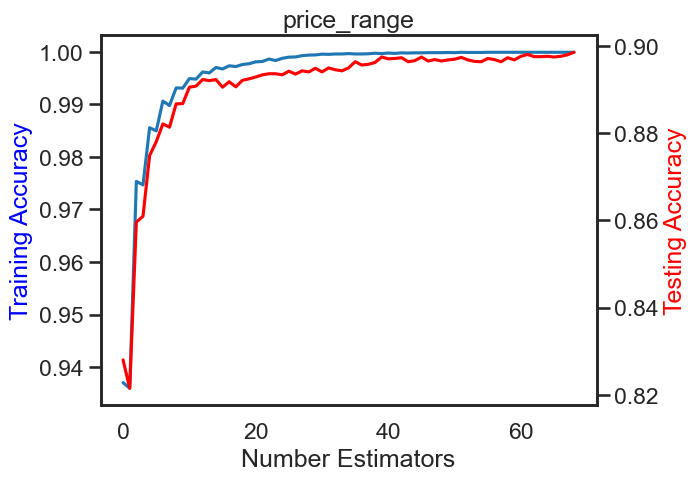

In [223]:
get_accuracy_bag(X, y, "price_range")

## Boosting and Stacking

In [224]:
error_list = list()
tree_list = [15, 25, 50, 100, 200, 400]
for n_trees in tree_list:
    gbc = GradientBoostingClassifier(n_estimators=n_trees, random_state=6767)
    
    print(f"Fitting model with {n_trees} trees")
    gbc.fit(X_train.values, y_train.values)
    y_pred = gbc.predict(X_test)

    error = 1 - accuracy_score(y_test, y_pred)

    error_list.append(pd.Series({"n_trees": n_trees, "error": error}))

error_df = pd.concat(error_list, axis=1).T.set_index("n_trees")
error_df

Fitting model with 15 trees
Fitting model with 25 trees
Fitting model with 50 trees
Fitting model with 100 trees
Fitting model with 200 trees
Fitting model with 400 trees


,error
n_trees,
15.0,0.206667
25.0,0.168333
50.0,0.128333
100.0,0.111667
200.0,0.111667
400.0,0.120000


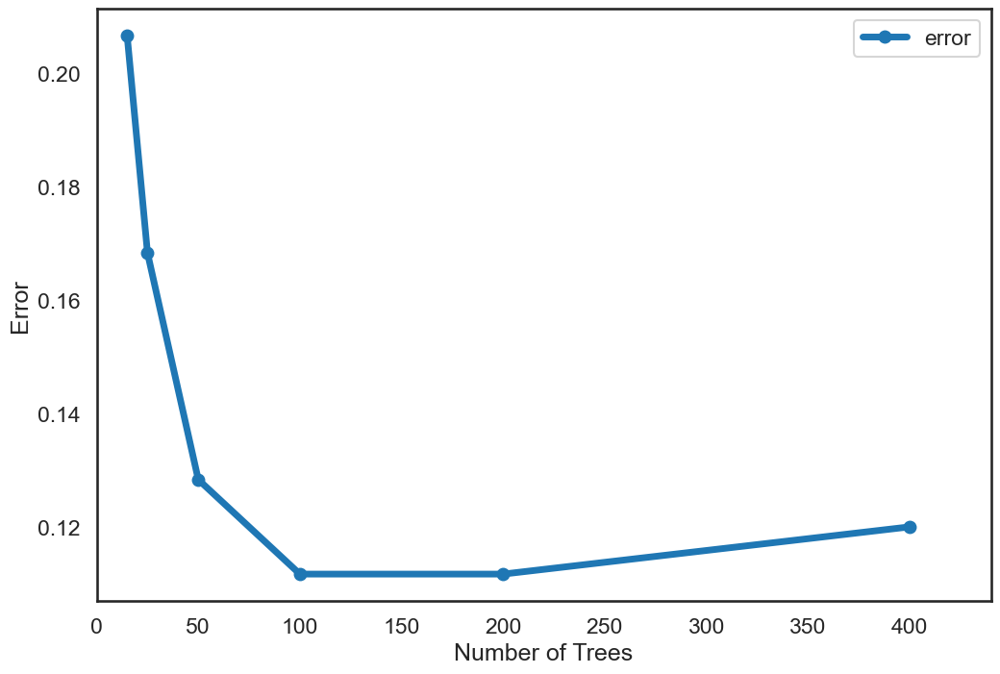

In [ ]:
ax = error_df.plot(marker="o", figsize=(12, 8), linewidth=5)
ax.set(xlabel="Number of Trees", ylabel="Error")
ax.set_xlim(0, max(error_df.index)*1.1);

In [226]:
param_grid = {"n_estimators": tree_list,
                "learning_rate": [0.1, 0.01, 0.001, 0.0001],
                "subsample": [1.0, 0.5],
                "max_features": [1,2,3,4]}
                

gs_gbc = GridSearchCV(GradientBoostingClassifier(random_state=676), param_grid=param_grid, scoring="accuracy", n_jobs=-1)

gs_gbc = gs_gbc.fit(X_train, y_train)

In [227]:
gs_gbc.best_estimator_

,loss,'log_loss'
,learning_rate,0.1
,n_estimators,400
,subsample,1.0
,criterion,'friedman_mse'
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_depth,3
,min_impurity_decrease,0.0
,init,None


In [228]:
y_pred = gs_gbc.predict(X_test)
print(classification_report(y_pred, y_test))

              precision    recall  f1-score   support

           0       0.96      0.88      0.92       162
           1       0.78      0.85      0.81       143
           2       0.83      0.83      0.83       157
           3       0.91      0.92      0.92       138

    accuracy                           0.87       600
   macro avg       0.87      0.87      0.87       600
weighted avg       0.87      0.87      0.87       600



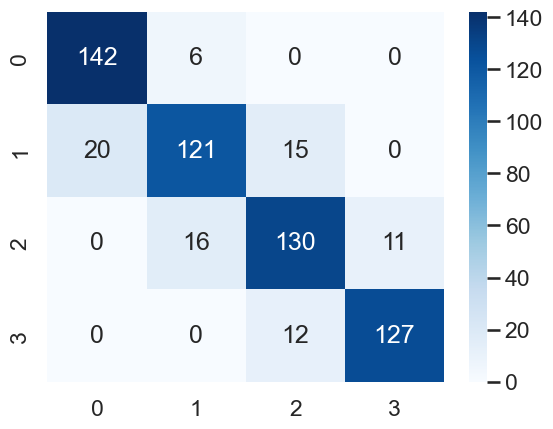

In [229]:
confus_mat = confusion_matrix(y_test, y_pred)
sns.heatmap(confus_mat, annot=True, fmt="g", cmap="Blues")
plt.show()

## Adaboost

In [230]:
abc = AdaBoostClassifier(DecisionTreeClassifier(max_depth=1))

param_grid = {"n_estimators": [100, 150, 200],
              "learning_rate": [0.01, 0.001]}

gs_abc = GridSearchCV(abc, param_grid=param_grid, scoring="accuracy", n_jobs=-1)
gs_abc = gs_abc.fit(X_train, y_train)

gs_abc.best_estimator_

,estimator,DecisionTreeC...r(max_depth=1)
,n_estimators,200
,learning_rate,0.01
,algorithm,'deprecated'
,random_state,None
,criterion,'gini'
,splitter,'best'
,max_depth,1
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0


              precision    recall  f1-score   support

           0       0.97      0.68      0.80       211
           1       0.49      0.68      0.57       113
           2       0.11      0.72      0.20        25
           3       0.99      0.55      0.71       251

    accuracy                           0.63       600
   macro avg       0.64      0.66      0.57       600
weighted avg       0.85      0.63      0.69       600



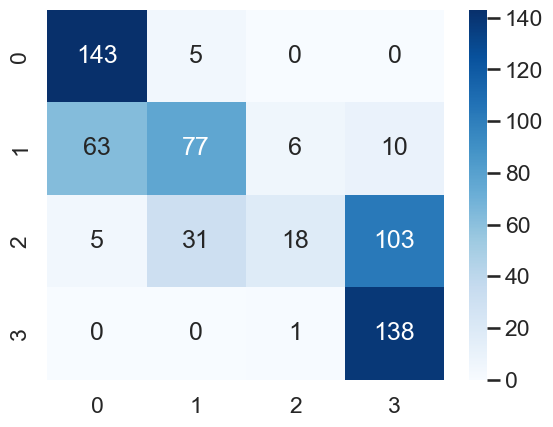

In [231]:
y_pred = gs_abc.predict(X_test)
print(classification_report(y_pred, y_test))

confus_mat = confusion_matrix(y_test, y_pred)
sns.heatmap(confus_mat, annot=True, fmt="g", cmap="Blues")
plt.show()

### Logistics Regression with Regularization and Voting Classifier

              precision    recall  f1-score   support

           0       0.86      0.80      0.83       158
           1       0.54      0.58      0.56       145
           2       0.43      0.54      0.48       124
           3       0.80      0.64      0.71       173

    accuracy                           0.65       600
   macro avg       0.66      0.64      0.64       600
weighted avg       0.67      0.65      0.66       600



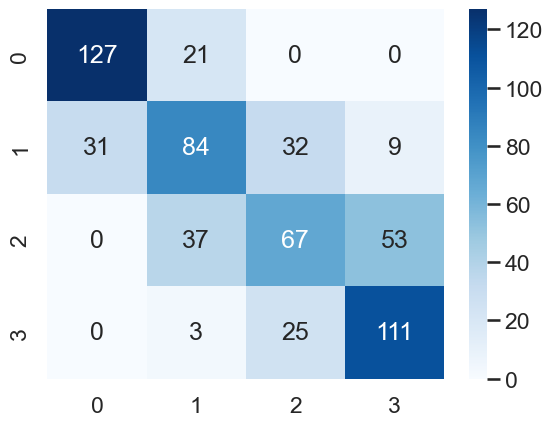

In [232]:
lr_l2 = LogisticRegression(penalty="l2", max_iter=500, solver="saga").fit(X_train, y_train)

y_pred = lr_l2.predict(X_test)
print(classification_report(y_pred, y_test))

confus_mat = confusion_matrix(y_test, y_pred)
sns.heatmap(confus_mat, annot=True, fmt="g", cmap="Blues")
plt.show()

In [233]:
estimators = [("LR_L2", lr_l2), ("GBC", gs_gbc)]

vc = VotingClassifier(estimators, voting="soft")
vc = vc.fit(X_train, y_train)

In [234]:
y_pred = vc.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.97      0.92       148
           1       0.85      0.76      0.80       156
           2       0.80      0.82      0.81       157
           3       0.91      0.89      0.90       139

    accuracy                           0.86       600
   macro avg       0.86      0.86      0.86       600
weighted avg       0.86      0.86      0.86       600



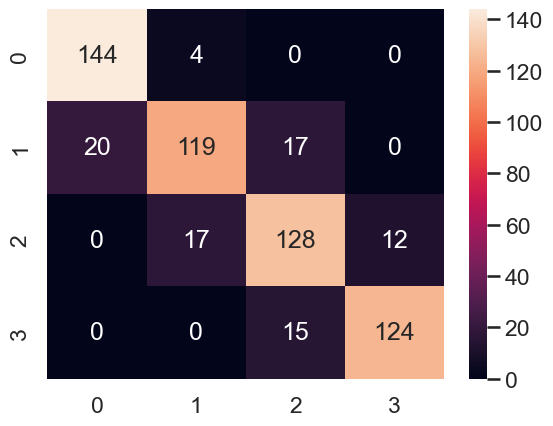

In [ ]:
confus_mat = confusion_matrix(y_test, y_pred)
sns.heatmap(confus_mat, annot=True, fmt="d")
plt.show()

## Adaptive Boosting for Classification with Python

In [236]:
def get_accuracy(X_train, X_test, y_train, y_test, model):
    return {"Test Accuracy":metrics.accuracy_score(y_test, model.predict(X_test)), "Train Accuracy": metrics.accuracy_score(y_train, model.predict(X_train))}

def get_accuracy_bag(X, y, title, times=20, xlabel="Number Estimators", Learning_rate_=[0.2, 0.4, 0.6, 1]):
    lines_array=["solid", "--", "-.", ":"]
    N_estimators = [n for n in range(1,100)]

    times = 20
    train_acc = np.zeros((times, len(Learning_rate_), len(N_estimators)))
    test_acc = np.zeros((times, len(Learning_rate_), len(N_estimators)))

    for n in tqdm (range(times)):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
        for n_estimators in N_estimators:
            for j, lr in enumerate(Learning_rate_):
                model = AdaBoostClassifier(n_estimators=n_estimators+1, random_state=6767, learning_rate=lr)
                model.fit(X_train, y_train)
                Accuracy = get_accuracy(X_train, X_test, y_train, y_test, model)
                train_acc[n, j, n_estimators-1] = Accuracy["Train Accuracy"]
                test_acc[n, j, n_estimators-1] = Accuracy["Test Accuracy"]

    fig, ax1 = plt.subplots()
    mean_test = test_acc.mean(axis=0)
    mean_train = train_acc.mean(axis=0)
    ax2 = ax1.twinx()

    for j, (lr,line) in enumerate(zip(Learning_rate_, lines_array)):
        ax1.plot(mean_train[j, :], linestyle = line, color="b", label="Learning rate " + str(lr))
        ax2.plot(mean_test[j, :], linestyle=line, color="r", label=str(lr))

    ax1.set_ylabel("Training accuracy", color="b")
    ax1.set_xlabel("No of estimators")
    ax1.legend()
    ax2.set_ylabel("Testing Accuracy", color="r")
    ax2.legend()
    plt.show()



In [237]:
n_estimators = 5
random_state = 6767

model = AdaBoostClassifier(n_estimators=n_estimators, random_state=random_state)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
y_pred

array([2, 0, 1, 0, 0, 1, 2, 2, 0, 2, 2, 0, 1, 2, 2, 2, 2, 0, 0, 2, 2, 0,
       1, 2, 2, 2, 2, 0, 2, 0, 2, 2, 2, 1, 2, 2, 0, 2, 2, 1, 2, 0, 0, 2,
       1, 0, 1, 1, 2, 2, 2, 2, 0, 1, 0, 0, 0, 1, 2, 2, 2, 2, 2, 2, 1, 2,
       0, 2, 0, 2, 2, 1, 2, 2, 2, 2, 2, 0, 2, 0, 1, 0, 0, 2, 0, 0, 0, 0,
       2, 2, 0, 2, 2, 2, 1, 0, 1, 2, 1, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 2,
       1, 2, 2, 0, 2, 0, 0, 2, 2, 1, 0, 2, 0, 2, 2, 0, 2, 0, 0, 0, 0, 2,
       1, 0, 1, 1, 2, 1, 0, 2, 2, 1, 2, 0, 2, 0, 1, 0, 0, 2, 0, 2, 1, 1,
       2, 0, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0, 2, 2, 2, 1,
       1, 0, 1, 1, 0, 2, 2, 0, 1, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 0, 1,
       0, 0, 0, 2, 0, 2, 2, 2, 1, 2, 0, 2, 1, 1, 0, 2, 0, 2, 0, 2, 2, 1,
       0, 2, 1, 2, 1, 0, 2, 0, 1, 2, 2, 1, 2, 2, 2, 0, 2, 0, 2, 2, 2, 0,
       0, 0, 2, 2, 0, 2, 2, 2, 1, 2, 2, 2, 1, 2, 1, 0, 2, 1, 0, 2, 2, 0,
       2, 2, 1, 2, 1, 0, 2, 2, 0, 2, 0, 0, 2, 2, 1, 2, 1, 2, 0, 0, 2, 1,
       2, 2, 2, 0, 2, 2, 1, 0, 2, 1, 2, 1, 0, 1, 0,

In [238]:
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.5683333333333334, 'Train Accuracy': 0.5621428571428572}


In [239]:
model.estimator_

,criterion,'gini'
,splitter,'best'
,max_depth,1
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,None
,random_state,None
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,class_weight,None


In [240]:
model.estimators_

[DecisionTreeClassifier(max_depth=1, random_state=752652289),
 DecisionTreeClassifier(max_depth=1, random_state=1429294821),
 DecisionTreeClassifier(max_depth=1, random_state=1340983805),
 DecisionTreeClassifier(max_depth=1, random_state=1099198555),
 DecisionTreeClassifier(max_depth=1, random_state=534709769)]

In [241]:
[("For week classifiers {} we get ".format(i+1),get_accuracy(X_train, X_test, y_train, y_test, weak_classifiers)) for i, weak_classifiers in enumerate (model.estimators_)]

[('For week classifiers 1 we get ',
  {'Test Accuracy': 0.4766666666666667, 'Train Accuracy': 0.5071428571428571}),
 ('For week classifiers 2 we get ',
  {'Test Accuracy': 0.435, 'Train Accuracy': 0.4057142857142857}),
 ('For week classifiers 3 we get ',
  {'Test Accuracy': 0.49166666666666664,
   'Train Accuracy': 0.4857142857142857}),
 ('For week classifiers 4 we get ',
  {'Test Accuracy': 0.465, 'Train Accuracy': 0.4857142857142857}),
 ('For week classifiers 5 we get ',
  {'Test Accuracy': 0.49166666666666664,
   'Train Accuracy': 0.4857142857142857})]

In [242]:
n_estimators = 100
random_state = 6767

model = AdaBoostClassifier(n_estimators=n_estimators, random_state=random_state)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.6133333333333333, 'Train Accuracy': 0.655}


100%|██████████| 20/20 [02:29<00:00,  7.49s/it]


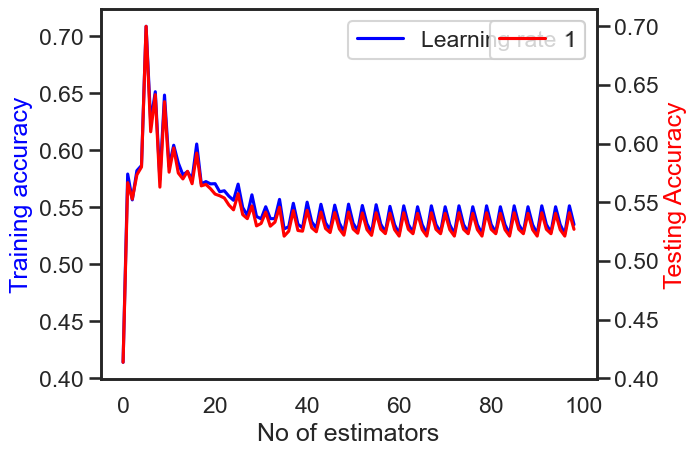

In [243]:
get_accuracy_bag(X, y, title="Training and Test Accuracy vs Weak Classifiers", Learning_rate_ = [1], times=20, xlabel="Number Estimators")

In [244]:
n_estimators = 100
random_state = 6767
learning_rate = 0.7

model = AdaBoostClassifier(n_estimators=n_estimators, random_state=random_state, learning_rate=learning_rate)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.6783333333333333, 'Train Accuracy': 0.7228571428571429}


100%|██████████| 20/20 [10:03<00:00, 30.18s/it]


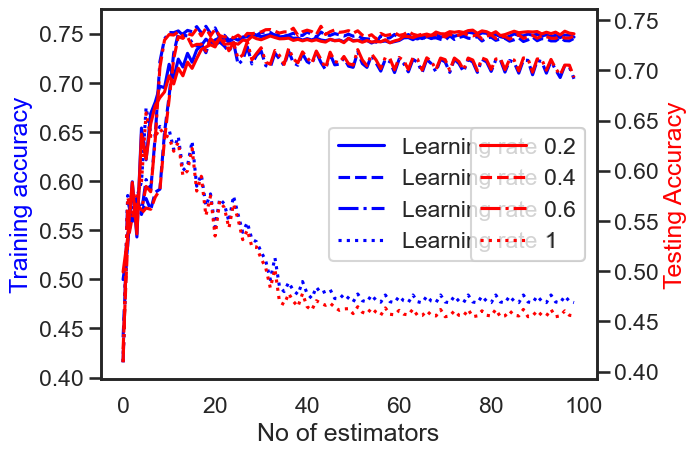

In [245]:
get_accuracy_bag(X, y, title="Training and Test Accuracy vs Weak Classifiers", Learning_rate_=[0.2, 0.4, 0.6, 1], times=20, xlabel="Number Estimators")

In [246]:
base_estimator=SVC(kernel="rbf", gamma=1)
base_estimator.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, base_estimator))

algorithm="SAMME"
model = AdaBoostClassifier(n_estimators=5, estimator=base_estimator, learning_rate=1, algorithm="SAMME")
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.23166666666666666, 'Train Accuracy': 1.0}
{'Test Accuracy': 0.23166666666666666, 'Train Accuracy': 0.25785714285714284}


In [247]:
model = AdaBoostClassifier()
model.get_params().keys()

dict_keys(['algorithm', 'estimator', 'learning_rate', 'n_estimators', 'random_state'])

In [248]:
param_grid = {"learning_rate": [0.1*(n+1) for n in range(10)],
              "n_estimators" : [2*n+1 for n in range(10)],
              "algorithm": ["SAMME", "SAMME.R"]}

param_grid

{'learning_rate': [0.1,
  0.2,
  0.30000000000000004,
  0.4,
  0.5,
  0.6000000000000001,
  0.7000000000000001,
  0.8,
  0.9,
  1.0],
 'n_estimators': [1, 3, 5, 7, 9, 11, 13, 15, 17, 19],
 'algorithm': ['SAMME', 'SAMME.R']}

In [249]:
search = GridSearchCV(estimator=model, param_grid=param_grid, scoring="accuracy", cv=3)
search.fit(X_train, y_train)

,estimator,AdaBoostClassifier()
,param_grid,"{'algorithm': ['SAMME', 'SAMME.R'], 'learning_rate': [0.1, 0.2, ...], 'n_estimators': [1, 3, ...]}"
,scoring,'accuracy'
,n_jobs,None
,refit,True
,cv,3
,verbose,0
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,estimator,None


In [250]:
search.best_score_

np.float64(0.7507252636835124)

In [251]:
search.best_params_

{'algorithm': 'SAMME', 'learning_rate': 0.5, 'n_estimators': 19}

In [252]:
print(get_accuracy(X_train, X_test, y_train, y_test, search.best_estimator_))

{'Test Accuracy': 0.7133333333333334, 'Train Accuracy': 0.7542857142857143}


## Stacking for Classification

Stacking takes several classification models' outputs and uses them as input for the meta-classifier.

In [253]:
estimators = [("SVM", SVC(random_state=6767)), ("KNN", KNeighborsClassifier()), ("dt", DecisionTreeClassifier())]
estimators

[('SVM', SVC(random_state=6767)),
 ('KNN', KNeighborsClassifier()),
 ('dt', DecisionTreeClassifier())]

In [254]:
clf = StackingClassifier(estimators=estimators, final_estimator=LogisticRegression())
clf.fit(X_train, y_train)
clf

,estimators,"[('SVM', ...), ('KNN', ...), ...]"
,final_estimator,LogisticRegression()
,cv,None
,stack_method,'auto'
,n_jobs,None
,passthrough,False
,verbose,0
,C,1.0
,kernel,'rbf'
,degree,3
,gamma,'scale'


In [255]:
y_pred = clf.predict(X_test)
y_pred

array([3, 0, 2, 0, 0, 1, 2, 3, 0, 2, 3, 0, 1, 2, 3, 3, 2, 0, 0, 2, 3, 0,
       2, 2, 2, 2, 3, 1, 2, 0, 2, 3, 3, 1, 3, 3, 0, 3, 3, 2, 3, 1, 1, 3,
       1, 0, 2, 1, 2, 3, 3, 2, 1, 1, 0, 1, 1, 1, 2, 3, 2, 3, 3, 2, 2, 2,
       0, 3, 0, 2, 2, 1, 3, 2, 2, 2, 2, 0, 2, 0, 1, 1, 0, 3, 1, 1, 0, 0,
       2, 3, 1, 2, 3, 2, 2, 0, 1, 2, 1, 1, 2, 2, 0, 3, 3, 0, 0, 1, 0, 3,
       1, 2, 2, 1, 3, 0, 0, 3, 2, 1, 1, 3, 0, 3, 3, 0, 3, 0, 0, 0, 0, 3,
       2, 0, 1, 1, 2, 2, 0, 2, 3, 1, 3, 0, 2, 0, 2, 0, 1, 2, 0, 2, 1, 2,
       3, 0, 0, 3, 3, 2, 2, 0, 3, 2, 2, 1, 2, 0, 2, 2, 2, 0, 3, 3, 3, 1,
       1, 0, 1, 1, 1, 1, 2, 0, 1, 0, 2, 3, 2, 1, 2, 2, 1, 2, 3, 3, 1, 1,
       0, 0, 0, 3, 1, 2, 3, 3, 1, 2, 0, 3, 2, 1, 0, 2, 0, 1, 1, 3, 3, 1,
       1, 3, 1, 3, 2, 0, 2, 0, 1, 2, 3, 1, 3, 2, 2, 1, 3, 1, 2, 3, 2, 1,
       1, 1, 3, 2, 0, 3, 3, 2, 1, 3, 2, 3, 1, 3, 1, 0, 3, 2, 1, 2, 3, 0,
       2, 2, 1, 2, 1, 0, 2, 2, 0, 3, 0, 1, 3, 3, 2, 2, 1, 2, 0, 0, 3, 1,
       3, 3, 2, 0, 3, 3, 1, 1, 3, 1, 2, 1, 0, 1, 0,

In [256]:
get_accuracy(X_train, X_test, y_train, y_test, clf)

{'Test Accuracy': 0.915, 'Train Accuracy': 0.9628571428571429}

In [257]:
estimators = [("SVM", SVC(random_state=6767)), ("KNN", KNeighborsClassifier()), ("lr", LogisticRegression())]
clf = StackingClassifier(estimators=estimators, final_estimator=DecisionTreeClassifier())
clf.fit(X_train, y_train)
get_accuracy(X_train, X_test, y_train, y_test, clf)

{'Test Accuracy': 0.9366666666666666, 'Train Accuracy': 0.9535714285714286}

In [258]:
estimators = [("SVM", SVC(random_state=6767)), ("knn", KNeighborsClassifier()), ("dt", DecisionTreeClassifier())]
estimators

[('SVM', SVC(random_state=6767)),
 ('knn', KNeighborsClassifier()),
 ('dt', DecisionTreeClassifier())]

In [259]:
clf = StackingClassifier(estimators=estimators, final_estimator = LogisticRegression())
clf

,estimators,"[('SVM', ...), ('knn', ...), ...]"
,final_estimator,LogisticRegression()
,cv,None
,stack_method,'auto'
,n_jobs,None
,passthrough,False
,verbose,0
,C,1.0
,kernel,'rbf'
,degree,3
,gamma,'scale'


In [260]:
param_grid = {"dt__max_depth": [n for n in range (10)], "dt__random_state": [0], "SVM__C": [0.001, 0.1, 1], "SVM__kernel": ["linear", "poly", "rbf"], "knn__n_neighbors":[1, 4, 8, 9]}
search = GridSearchCV(estimator = clf, param_grid=param_grid, scoring="accuracy")
search.fit(X_train, y_train)

,estimator,StackingClass...cRegression())
,param_grid,"{'SVM__C': [0.001, 0.1, ...], 'SVM__kernel': ['linear', 'poly', ...], 'dt__max_depth': [0, 1, ...], 'dt__random_state': [0], ...}"
,scoring,'accuracy'
,n_jobs,None
,refit,True
,cv,None
,verbose,0
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,C,0.001


In [261]:
search.best_score_

np.float64(0.9814285714285715)

In [262]:
search.best_params_

{'SVM__C': 0.001,
 'SVM__kernel': 'linear',
 'dt__max_depth': 1,
 'dt__random_state': 0,
 'knn__n_neighbors': 9}

In [263]:
get_accuracy(X_train, X_test, y_train, y_test, search)

{'Test Accuracy': 0.9583333333333334, 'Train Accuracy': 0.985}

## Gradient Boosting for Classification

In [264]:
def get_accuracy(X_train, X_test, y_train, y_test, model):
    return{"Test Accuracy": metrics.accuracy_score(y_test, model.predict(X_test)),
           "Train Accuracy": metrics.accuracy_score(y_train, model.predict(X_train))}

In [265]:
def get_accuracy_boost(X, y, title, times=20, xlabel="Number Estimators", Learning_rate_ = [0.2, 0.4, 0.6, 1], n_est = 100):
    lines_array = ["solid", "--", "-.", ":"]

    N_estimators = [n*2 for n in range(1, n_est//2)]

    train_acc = np.zeros((times, len(Learning_rate_), len(N_estimators)))
    test_acc = np.zeros((times, len(Learning_rate_), len(N_estimators)))

    for n in tqdm(range(times)):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
        for n_estimators in N_estimators:
            for j, lr in enumerate(Learning_rate_):
                model = XGBClassifier(objective=objective, learning_rate=lr, n_estimators=n_estimators, eval_metric="mlogloss")
                model.fit(X_train, y_train)
                Accuracy=get_accuracy(X_train, X_test, y_train, y_test, model)
                train_acc[n, j, (n_estimators//2)-1]=Accuracy["Train Accuracy"]
                test_acc[n, j, (n_estimators//2)-1]=Accuracy["Test Accuracy"]

    fig, ax1 = plt.subplots()
    mean_test = test_acc.mean(axis=0)
    mean_train = train_acc.mean(axis=0)
    ax2 = ax1.twinx()

    for j, (lr, line) in enumerate(zip(Learning_rate_, lines_array)):
        ax1. plot(mean_train[j, :], linestyle = line, color="b", label = "Learning rate "+str(lr))
        ax2.plot(mean_test[j, :], linestyle = line, color="r", label=str(lr))
    
    ax1.set_ylabel("Training accuracy", color="b")
    ax1.legend()
    ax2.set_ylabel("Testing accuracy", color="r")
    ax2.legend()
    ax1.set_xlabel(xlabel)
    plt.show()

In [268]:
n_estimators = 5
random_state = 6767
objective = "binary:logistic"
learning_rate = 0.1

model = XGBClassifier(objective=objective, learning_rate = learning_rate, n_estimators=n_estimators, eval_metric = "mlogloss")
model

,objective,'binary:logistic'
,base_score,None
,booster,None
,callbacks,None
,colsample_bylevel,None
,colsample_bynode,None
,colsample_bytree,None
,device,None
,early_stopping_rounds,None
,enable_categorical,False
,eval_metric,'mlogloss'


In [269]:
print("Learning rate:", model.learning_rate)
print("lobjective:", model.objective)
print("n_estimators:", model.n_estimators)

Learning rate: 0.1
lobjective: binary:logistic
n_estimators: 5


In [270]:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
y_pred

array([3, 0, 2, 0, 0, 1, 2, 2, 0, 3, 3, 0, 1, 2, 3, 3, 2, 0, 0, 2, 3, 0,
       2, 2, 2, 1, 3, 1, 2, 0, 2, 3, 3, 1, 3, 3, 0, 3, 3, 1, 3, 1, 1, 3,
       1, 0, 1, 1, 3, 3, 3, 2, 1, 1, 0, 1, 1, 1, 2, 3, 2, 3, 3, 1, 2, 2,
       0, 3, 0, 2, 2, 1, 3, 2, 2, 2, 2, 0, 2, 0, 2, 1, 0, 3, 1, 1, 0, 0,
       2, 3, 1, 3, 3, 2, 2, 0, 1, 3, 1, 0, 3, 2, 0, 3, 3, 1, 0, 0, 0, 3,
       1, 2, 3, 0, 3, 0, 0, 3, 2, 1, 0, 3, 0, 3, 3, 0, 2, 0, 0, 0, 0, 3,
       1, 0, 1, 1, 1, 2, 0, 2, 3, 2, 3, 0, 2, 0, 1, 0, 1, 2, 0, 3, 1, 2,
       3, 0, 1, 3, 3, 2, 2, 0, 3, 1, 2, 1, 2, 0, 2, 2, 2, 0, 2, 3, 3, 1,
       1, 0, 1, 1, 0, 1, 2, 0, 1, 0, 2, 3, 1, 1, 2, 2, 2, 3, 3, 3, 1, 1,
       0, 0, 0, 3, 1, 2, 3, 3, 1, 1, 0, 3, 2, 2, 0, 2, 0, 1, 1, 3, 3, 1,
       1, 3, 1, 3, 1, 0, 2, 0, 1, 1, 3, 1, 2, 2, 2, 1, 3, 0, 3, 3, 2, 1,
       0, 1, 3, 2, 0, 3, 3, 2, 1, 3, 3, 3, 1, 3, 1, 0, 3, 1, 1, 3, 3, 0,
       2, 2, 0, 2, 1, 0, 2, 2, 0, 3, 0, 1, 3, 3, 2, 2, 1, 2, 0, 0, 3, 1,
       3, 3, 2, 0, 3, 3, 1, 1, 2, 1, 3, 1, 0, 1, 0,

In [271]:
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.8366666666666667, 'Train Accuracy': 0.97}


In [272]:
learning_rate = 0.3
model = XGBClassifier(objective = objective, learning_rate = learning_rate, n_estimators = n_estimators)
model.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.8566666666666667, 'Train Accuracy': 0.9807142857142858}


In [273]:
n_estimators = 100
model = XGBClassifier(objective = objective, learning_rate = learning_rate, n_estimators=n_estimators)
model.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.8916666666666667, 'Train Accuracy': 1.0}


100%|██████████| 10/10 [00:04<00:00,  2.48it/s]


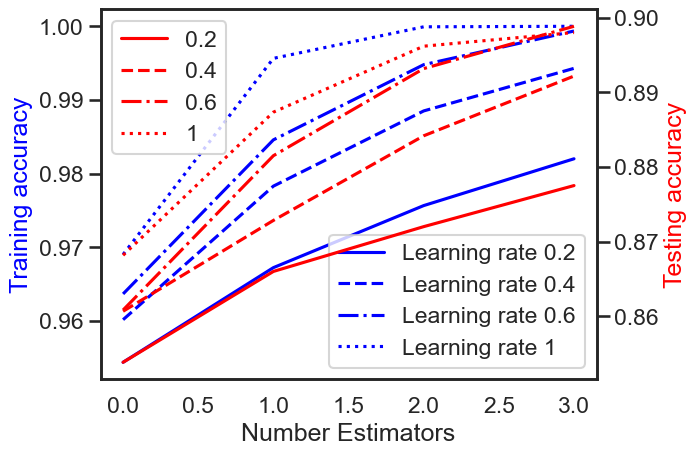

In [274]:
get_accuracy_boost(X, y, title="Training and Test Accuracy vs Weak Classifiers", times=10, xlabel = "Number Estimators", n_est=10)


In [ ]:
eval_set = [(X_test, y_test)]


model = XGBClassifier(
    objective=objective,
    learning_rate=learning_rate,
    n_estimators=n_estimators,
    eval_metric="mlogloss"
)

model.fit(
    X_train, y_train,
    eval_set=eval_set,
    verbose=True
)

results = model.evals_result()
print(results)

[0]	validation_0-mlogloss:1.03268
[1]	validation_0-mlogloss:0.82526
[2]	validation_0-mlogloss:0.69094
[3]	validation_0-mlogloss:0.60157
[4]	validation_0-mlogloss:0.52801
[5]	validation_0-mlogloss:0.47662
[6]	validation_0-mlogloss:0.43793
[7]	validation_0-mlogloss:0.41119
[8]	validation_0-mlogloss:0.38420
[9]	validation_0-mlogloss:0.36514
[10]	validation_0-mlogloss:0.35271
[11]	validation_0-mlogloss:0.33877
[12]	validation_0-mlogloss:0.32428
[13]	validation_0-mlogloss:0.31257
[14]	validation_0-mlogloss:0.30545
[15]	validation_0-mlogloss:0.29705
[16]	validation_0-mlogloss:0.29097
[17]	validation_0-mlogloss:0.28593
[18]	validation_0-mlogloss:0.27986
[19]	validation_0-mlogloss:0.27765
[20]	validation_0-mlogloss:0.27560
[21]	validation_0-mlogloss:0.27348
[22]	validation_0-mlogloss:0.27121
[23]	validation_0-mlogloss:0.27128
[24]	validation_0-mlogloss:0.27138
[25]	validation_0-mlogloss:0.27116
[26]	validation_0-mlogloss:0.27063
[27]	validation_0-mlogloss:0.27194
[28]	validation_0-mlogloss:0.2

Text(0, 0.5, 'Misclassified Samples')

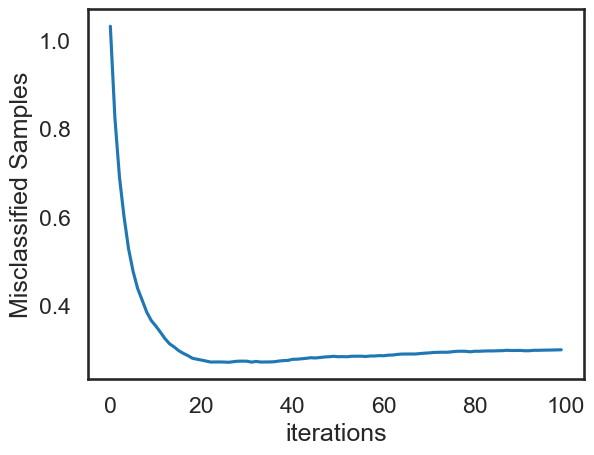

In [289]:
plt.plot(range(0, len(results["validation_0"]["mlogloss"])), results["validation_0"]["mlogloss"])
plt.xlabel("iterations")
plt.ylabel("Misclassified Samples")

In [ ]:
eval_set = [(X_train, y_train), (X_test, y_test)]


model = XGBClassifier(
    objective=objective,
    learning_rate=learning_rate,
    n_estimators=n_estimators,
    eval_metric="merror"
)

model.fit(
    X_train, y_train,
    eval_set=eval_set,
    verbose=True
)

results = model.evals_result()
print(results)

[0]	validation_0-merror:0.04571	validation_1-merror:0.19167
[1]	validation_0-merror:0.03857	validation_1-merror:0.16333
[2]	validation_0-merror:0.03429	validation_1-merror:0.15167
[3]	validation_0-merror:0.02357	validation_1-merror:0.14833
[4]	validation_0-merror:0.01929	validation_1-merror:0.14333
[5]	validation_0-merror:0.01643	validation_1-merror:0.14500
[6]	validation_0-merror:0.01214	validation_1-merror:0.13833
[7]	validation_0-merror:0.00929	validation_1-merror:0.13500
[8]	validation_0-merror:0.00643	validation_1-merror:0.13000
[9]	validation_0-merror:0.00571	validation_1-merror:0.13500
[10]	validation_0-merror:0.00429	validation_1-merror:0.13167
[11]	validation_0-merror:0.00357	validation_1-merror:0.12833
[12]	validation_0-merror:0.00214	validation_1-merror:0.12000
[13]	validation_0-merror:0.00071	validation_1-merror:0.11333
[14]	validation_0-merror:0.00071	validation_1-merror:0.11167
[15]	validation_0-merror:0.00071	validation_1-merror:0.11167
[16]	validation_0-merror:0.00071	v

In [293]:
results.keys()

dict_keys(['validation_0', 'validation_1'])

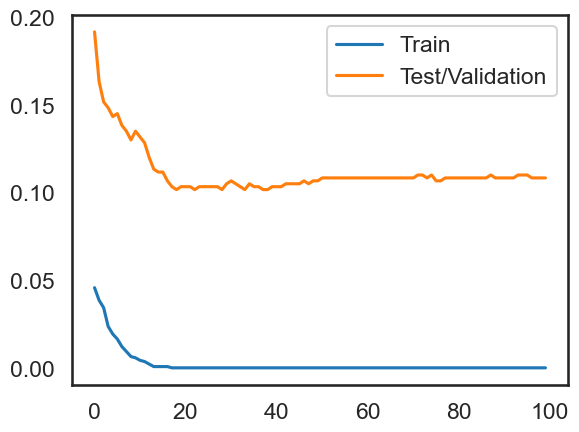

In [295]:
fig, ax = plt.subplots()
ax.plot(results["validation_0"]["merror"], label="Train")
ax.plot(results["validation_1"]["merror"], label="Test/Validation")
ax.legend()
plt.show()

### Parameters for Trees

In [318]:
objective = "binary:logistic"
learning_rate = 0.1
n_estimators=10
model = XGBClassifier(objective=objective, learning_rate=learning_rate, n_estimators=n_estimators, eval_metric="mlogloss")
model.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.8433333333333334, 'Train Accuracy': 0.9792857142857143}


In [319]:
model = XGBClassifier(objective=objective, learning_rate=learning_rate, n_estimators=n_estimators, eval_metric = "mlogloss", max_depth=max_depth)
model.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.8366666666666667, 'Train Accuracy': 0.9607142857142857}


In [320]:
min_child_weight = 4
model = XGBClassifier(objective=objective, learning_rate = learning_rate, n_estimators=n_estimators, eval_metric="mlogloss", min_child_weight=min_child_weight)
model.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.845, 'Train Accuracy': 0.9492857142857143}


In [321]:
gamma = 1
reg_lambda=2
alpha=1
model = XGBClassifier(objective=objective, learning_rate = learning_rate, n_estimators=n_estimators, eval_metric="mlogloss", gamma=gamma, reg_lambda=reg_lambda, alpha=alpha)
model.fit(X_train, y_train)
print(get_accuracy(X_train, X_test, y_train, y_test, model))

{'Test Accuracy': 0.8383333333333334, 'Train Accuracy': 0.9428571428571428}


In [322]:
model = XGBClassifier(objective="binary:logistic", eval_metric="mlogloss")
param_grid = {"learning_rate": [0.1*(n+1) for n in range(5)],
              "n_estimators": [2*n+1 for n in range(5)]}

search = GridSearchCV(estimator=model, param_grid=param_grid,scoring="neg_log_loss")
search.fit(X_train, y_train)
search.best_score_

np.float64(-0.2866515105852932)

In [323]:
search.best_params_

{'learning_rate': 0.5, 'n_estimators': 9}

In [324]:
print(get_accuracy(X_train, X_test, y_train, y_test, search.best_estimator_))

{'Test Accuracy': 0.8766666666666667, 'Train Accuracy': 0.9985714285714286}


## Model-agnostic Explanations

In [331]:
black_box_model = RandomForestClassifier(random_state=6767, max_depth=25,
                                         max_features=10, n_estimators=100,
                                         bootstrap=True)
black_box_model.fit(X_train, y_train.values.ravel())

,n_estimators,100
,criterion,'gini'
,max_depth,25
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,10
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


In [333]:
y_blackbox = black_box_model.predict(X_test)

y_probs = black_box_model.predict_proba(X_test)

roc_auc = metrics.roc_auc_score(y_test, y_probs, multi_class="ovr")

print("ROC AUC:", roc_auc)

ROC AUC: 0.9837919725649985


### Permutation Feature Importance

In [334]:
feature_importances = permutation_importance(estimator=black_box_model, X = X_train, y= y_train, n_repeats=5, random_state=6767, n_jobs=2)

In [335]:
feature_importances.importances.shape

(20, 5)

In [336]:
feature_importances.importances

array([[1.87857143e-01, 1.67142857e-01, 1.83571429e-01, 1.76428571e-01,
        1.77142857e-01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00],
       [2.14285714e-03, 7.14285714e-04, 7.14285714e-04, 1.42857143e-03,
        1.42857143e-03],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 7.14285714e-04, 7.14285714e-04,
        7.14285714e-04],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00],
       [0.00000000e+00, 0.0000

In [337]:
def visualize_feature_importance(importance_array):
    sorted_idx = importance_array.importances_mean.argsort()
    fig, ax = plt.subplots()
    fig.set_figwidth(16)
    fig.set_figheight(10)
    fig.tight_layout()
    ax.boxplot(importance_array.importances[sorted_idx].T,
               vert=False, labels=X_train.columns[sorted_idx])
    
    ax.set_title("Permutation Importances (train set)")
    plt.show()

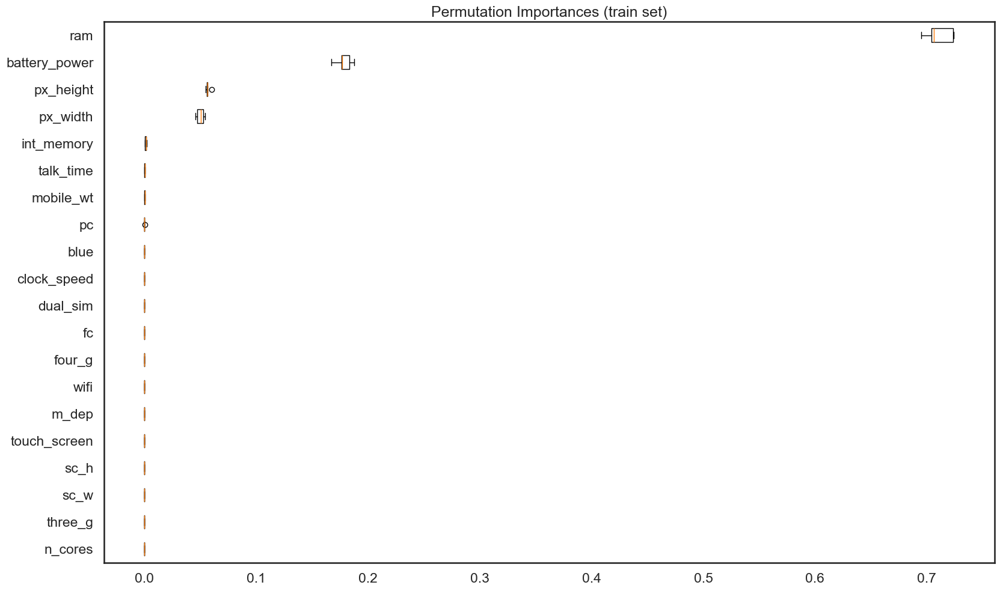

In [339]:
visualize_feature_importance(feature_importances)

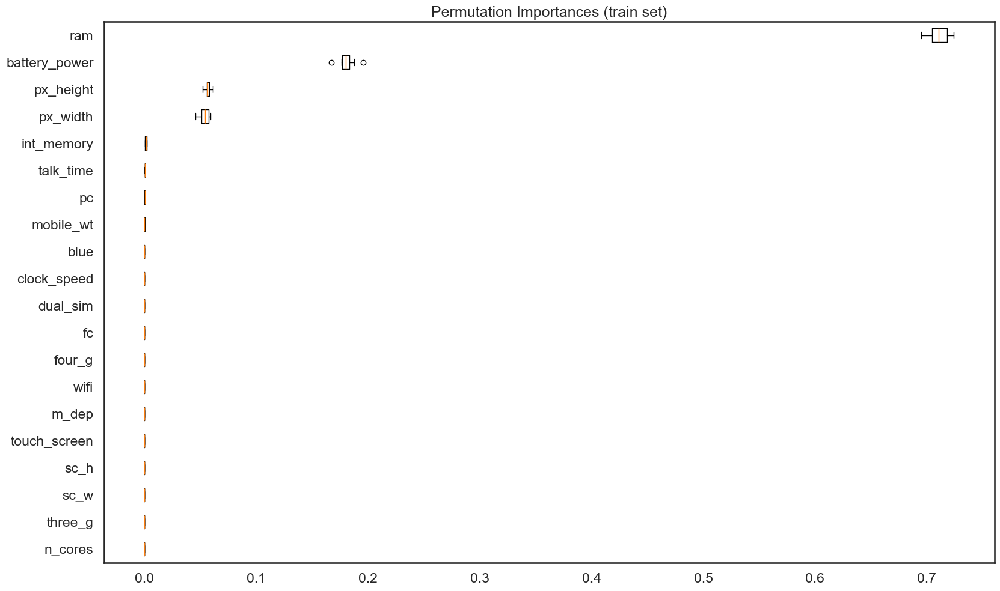

In [341]:
feature_importances = permutation_importance(estimator = black_box_model, X=X_train, y=y_train, n_repeats=10,
                                             random_state=6767, n_jobs=2)

visualize_feature_importance(feature_importances)

### Global Surrogate Model

In [348]:
min_max_scaler = StandardScaler()
X_test_minmax = min_max_scaler.fit_transform(X_test)

In [349]:
lm_surrogate = LogisticRegression(max_iter=1000,
                                  random_state=6767, penalty="l1", solver="liblinear")
lm_surrogate.fit(X_test_minmax, y_blackbox)

,penalty,'l1'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,6767
,solver,'liblinear'
,max_iter,1000
,multi_class,'deprecated'


In [350]:
y_surrogate = lm_surrogate.predict(X_test_minmax)
metrics.accuracy_score(y_blackbox, y_surrogate)

0.87

In [351]:
def get_feature_coefs(regression_model):
    coef_dict = {}
    for coef, feat in zip(regression_model.coef_[0, :], X_test.columns):
        if abs(coef) >= 0.01:
            coef_dict[feat] = coef
    coef_dict = {k: v for k, v in sorted(coef_dict.items(), key = lambda item: item[1])}
    return coef_dict

In [352]:
coef_dict = get_feature_coefs(lm_surrogate)
coef_dict

{'ram': np.float64(-10.593067168780502),
 'battery_power': np.float64(-2.158582343428351),
 'px_height': np.float64(-1.481117320684323),
 'px_width': np.float64(-0.5234598855982072),
 'touch_screen': np.float64(-0.09943210624893664),
 'four_g': np.float64(-0.0800546057401558),
 'wifi': np.float64(-0.050516260417329005),
 'pc': np.float64(-0.04509526260391922),
 'm_dep': np.float64(-0.04392099810357781),
 'blue': np.float64(-0.03750296361764406),
 'talk_time': np.float64(0.04836714422160825),
 'int_memory': np.float64(0.06510153549620251),
 'sc_h': np.float64(0.09717638802811639)}

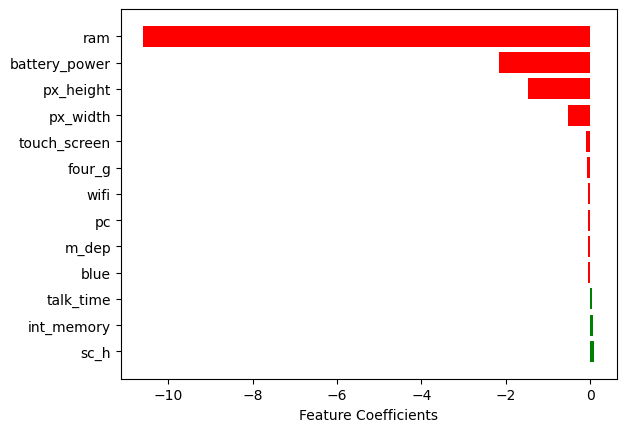

In [354]:
visualize_coefs(coef_dict)

In [356]:
tree_surrogate = DecisionTreeClassifier(random_state = 6767,
                                        max_depth = 5,
                                        max_features = 10)
tree_surrogate.fit(X_test, y_blackbox)
y_surrogate = tree_surrogate.predict(X_test)

In [357]:
metrics.accuracy_score(y_blackbox, y_surrogate)

0.8333333333333334

In [361]:
tree_exp = export_text(tree_surrogate, feature_names=list(X_train.columns))
print(tree_exp)

|--- ram <= 1512.50
|   |--- battery_power <= 1395.00
|   |   |--- battery_power <= 1067.50
|   |   |   |--- mobile_wt <= 195.50
|   |   |   |   |--- px_height <= 1245.00
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- px_height >  1245.00
|   |   |   |   |   |--- class: 0
|   |   |   |--- mobile_wt >  195.50
|   |   |   |   |--- px_height <= 1443.00
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- px_height >  1443.00
|   |   |   |   |   |--- class: 1
|   |   |--- battery_power >  1067.50
|   |   |   |--- m_dep <= 0.25
|   |   |   |   |--- ram <= 1030.00
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- ram >  1030.00
|   |   |   |   |   |--- class: 1
|   |   |   |--- m_dep >  0.25
|   |   |   |   |--- ram <= 1434.00
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- ram >  1434.00
|   |   |   |   |   |--- class: 1
|   |--- battery_power >  1395.00
|   |   |--- px_width <= 1771.50
|   |   |   |--- ram <= 1109.50
|   |   |   |   |--- battery_power <= 1479.00
|   |

### Local Interpreatable Model-Agnostic Explanations

In [370]:
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data = X_test.values,
    mode = "classification",
    class_names = ["Not Changing", "Changing"],
    feature_names = list(X_train.columns),
    random_state = 6767,
    verbose=True
)

In [372]:
instance_index = 19
selected_instance = X_test.iloc[[instance_index]]
lime_test_instance = selected_instance.values.reshape(-1)
selected_instance

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
1918,772,0,1.0,1,0,1,23,0.6,97,7,11,317,1805,2782,7,0,17,1,0,0


Intercept 0.2848893885432687
Prediction_local [0.16591079]
Right: 0.07


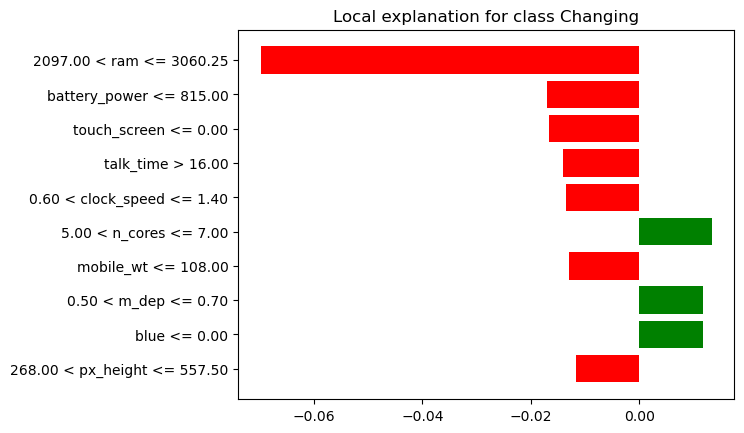

In [373]:
exp = explainer.explain_instance(
    lime_test_instance,
    black_box_model.predict_proba,
    num_features=10)
exp.as_pyplot_figure();